In [1]:
import numpy as np 
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd

In [2]:
file_name = r'../data/centroids_all_NOR_1x1.pkl'
with open(r"../data/centroids_all_NOR_1x1.pkl", "rb") as file:
    df_2020 = pickle.load(file)

df_2020

,geometry,latitude,longitude
0,"POLYGON ((-113396.708 6723593.459, -113453.164...",60.184377,3.906250
1,"POLYGON ((-77147.252 6615574.499, -77162.706 6...",59.283751,4.848241
2,"POLYGON ((-75472.701 6617359.522, -75472.701 6...",59.297719,4.867749
3,"POLYGON ((-75472.701 6618359.522, -75472.701 6...",59.304152,4.862960
4,"POLYGON ((-75472.701 6618359.522, -76100.492 6...",59.310679,4.862359
...,...,...,...
346441,"POLYGON ((1113527.299 7802359.522, 1113527.299...",69.607836,30.939583
346442,"POLYGON ((1113527.299 7803359.522, 1113527.299...",69.616178,30.942661
346443,"POLYGON ((1113527.299 7804359.522, 1113527.299...",69.622347,30.944938
346444,"POLYGON ((1114527.299 7800359.522, 1114562.802...",69.584592,30.942218


In [3]:
# Ensure geometries are in lat/lon (WGS84)
df_2020 = df_2020.to_crs(epsg=4326)

# Get centroids of polygons
df_2020['centroid'] = df_2020.geometry.centroid

# Extract lat/lon from centroids
df_2020['lat'] = df_2020.centroid.y
df_2020['lon'] = df_2020.centroid.x

# Define bin size
bin_size = 0.08

# Create lat/lon bins
df_2020['lat_bin'] = (df_2020['lat'] / bin_size).round(0) * bin_size
df_2020['lon_bin'] = (df_2020['lon'] / bin_size).round(0) * bin_size

# Sample one centroid per bin
sampled = df_2020.groupby(['lat_bin', 'lon_bin']).sample(n=1, random_state=42).reset_index(drop=True)

print(f"Sampled: {len(sampled)} polygons")


C:\Users\Raul\AppData\Local\Temp\ipykernel_13416\3750591863.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  df_2020['centroid'] = df_2020.geometry.centroid
C:\Users\Raul\AppData\Local\Temp\ipykernel_13416\3750591863.py:8: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  df_2020['lat'] = df_2020.centroid.y
C:\Users\Raul\AppData\Local\Temp\ipykernel_13416\3750591863.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  df_2020['lon'] = df_2020.centroid.x


Sampled: 11470 polygons


In [4]:
sampled

,geometry,latitude,longitude,centroid,lat,lon,lat_bin,lon_bin
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,POINT (6.99775 58.02829),58.028286,6.997755,58.0,6.96
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,POINT (7.05014 58.02217),58.022171,7.050138,58.0,7.04
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,POINT (7.08638 57.99091),57.990907,7.086381,58.0,7.12
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,POINT (7.21969 58.02657),58.026571,7.219693,58.0,7.20
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,POINT (7.28573 58.02973),58.029728,7.285729,58.0,7.28
...,...,...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,POINT (25.5495 71.16069),71.160690,25.549503,71.2,25.52
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,POINT (25.62173 71.1602),71.160205,25.621730,71.2,25.60
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,POINT (25.66277 71.17527),71.175275,25.662774,71.2,25.68
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,POINT (25.79059 71.16668),71.166685,25.790593,71.2,25.76


### Plotting Samples Distribution

In [5]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

def plotting_samples_norway(df):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Step 2: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Assuming 'result' DataFrame has columns 'longitude' and 'latitude' (from the grid centroids)
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points inside Norway
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label="Assemblages")
    
    # Customize plot
    ax.set_title("Randomly Sampled Grids 2060-2080", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    
    # Show the plot
    plt.show()

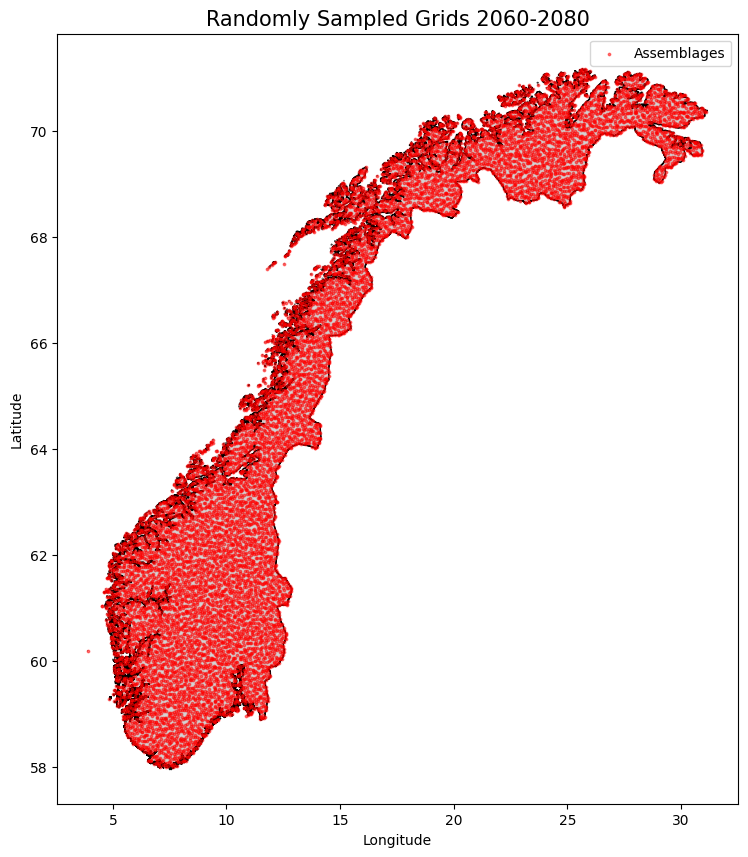

In [6]:
plotting_samples_norway(sampled)

### Generating Climatic Maps

In [7]:
import netCDF4  # or import h5netcdf
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [8]:
def read_netcdf_stack(file_paths, latitude, longitude, grid):
    patches = []
    # scaler = MinMaxScaler(feature_range=(0, 1))  # Define the scaler

    for file_path in file_paths:
        data = xr.open_dataset(file_path)
        variable = list(data.data_vars.keys())[-1]

        lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
        lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        ).fillna(0).values  # Convert to NumPy

        print(f"Shape of patch for {file_path} {variable}: {patch.shape}")

        # Remove extra dimension if necessary
        if patch.shape[0] == 1:
            patch = patch[0]

        # # Reshape for MinMax scaling (flatten to 2D)
        # patch_reshaped = patch.reshape(-1, 1)  # Flatten but keep 1 feature

        # # Apply MinMax Scaling
        # patch_scaled = scaler.fit_transform(patch_reshaped)

        # # Reshape back to original (grid*2, grid*2)
        # patch_scaled = patch_scaled.reshape(patch.shape)

        # patches.append(patch_scaled)  # Add scaled patch
        
        patches.append(patch)  # Add NOT scaled patch


    # Stack along last axis (channels dimension)
    stacked_patches = np.stack(patches, axis=-1)

    return stacked_patches

In [9]:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables =['gdd5','bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd']
scenario = 'rcp85'
year = '2061-2080'
stacked_patches_list = []
# x = 100
for i in range(sampled.shape[0]): # gbif_assemblages.shape[0]
    sample =  sampled.iloc[i]
    file_paths = [f"../data/Future/HIRHAM5/{scenario}/2061-2080/CHELSA_HIRHAM5_{scenario}_{var}_2061-2080_V.1.0.nc" for var in variables]
    file_paths.append(path_altitude)
    
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                        latitude = sample.latitude, 
                                        longitude = sample.longitude, 
                                        grid = 16) # better to use multiples of 64
    
    stacked_patches_list.append(stacked_patches)

    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 13 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 16 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 23 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 26 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas:

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 29 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 32 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp8

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 42 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 49 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 52 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas:

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 62 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 65 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 68 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 75 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 85 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 88 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 91 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 101 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 108 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 111 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 124 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 128 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 131 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 138 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 148 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 155 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 158 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 168 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 185 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 192 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 195 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 215 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 222 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 225 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 235 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 241 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 248 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 258 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 261 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 265 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 281 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 284 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 287 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 297 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 307 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 324 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 327 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 334 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 344 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 351 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 361 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 365 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 368 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 375 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 378 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 389 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 396 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 399 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 409 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 416 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 419 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 422 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 429 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 436 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 446 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 449 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 459 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 462 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 469 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 476 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 483 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 486 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 496 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 513 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 516 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 523 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 533 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 540 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 543 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 557 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 560 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 567 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 577 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 584 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 587 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 600 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 610 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 617 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 629 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 636 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 639 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 642 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 652 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 655 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 662 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 672 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 679 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 682 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 692 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 699 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 702 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 706 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 709 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 719 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 722 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 729 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 746 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 749 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 752 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 755 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 765 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 785 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 788 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 795 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 798 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 801 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 814 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 817 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 827 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 834 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 837 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 847 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 850 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 857 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 860 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 867 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 870 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 873 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 883 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 886 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 890 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 893 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 900 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 903 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 913 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 930 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 933 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 940 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 946 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 953 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 966 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 969 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 982 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 985 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 988 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 998 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1001 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1004 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1011 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1014 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1017 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1021 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1031 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1044 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1051 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1054 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1061 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1064 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1071 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1078 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1088 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1098 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1114 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1124 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1134 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1141 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1144 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1158 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1168 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1188 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1198 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1201 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1208 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1218 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1221 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1224 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1228 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1235 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1248 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1261 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1278 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1281 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1291 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1294 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1297 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1327 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1330 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1333 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1340 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1343 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1353 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1356 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1366 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1379 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1386 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1393 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1396 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1403 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1406 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1412 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1415 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1418 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1421 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1428 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1438 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1441 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1444 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1451 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1461 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1468 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1471 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1484 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1487 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1516 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1519 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1522 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1529 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1532 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1546 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1549 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 1555 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1562 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1566 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1569 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1579 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1582 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1592 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1602 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1605 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1608 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1618 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1621 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1624 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1634 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1637 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1640 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1647 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1650 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1657 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1660 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1667 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1670 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1680 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1683 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1693 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1697 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1703 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1707 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1723 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1726 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1736 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1743 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1746 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1749 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1759 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1762 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1765 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1785 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1788 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1798 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1801 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1808 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1818 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1821 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1828 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1831 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1844 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1848 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1851 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1854 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1864 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1867 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1874 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1877 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1890 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1900 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1903 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1913 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1923 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1926 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1933 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1936 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1946 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1949 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1952 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1962 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1969 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1972 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1985 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1988 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1991 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2001 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2004 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2007 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2014 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2017 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2020 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2027 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2030 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2037 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2040 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2047 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2050 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2063 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2066 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2076 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2079 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2086 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2096 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2103 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2109 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2116 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2119 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2122 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2132 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2145 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2148 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2158 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2161 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2167 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2174 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2177 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2191 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2194 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2200 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2203 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2207 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2210 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2213 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2223 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2226 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2230 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2233 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2236 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2243 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2246 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2253 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2256 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2266 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2269 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2272 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2275 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2285 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2292 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2301 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2308 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2311 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2324 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2327 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2330 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2340 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2343 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2346 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2352 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2365 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 2371 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2378 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2384 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2394 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2397 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2400 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2403 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2410 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2413 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2416 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2426 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2429 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2432 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2445 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2458 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2461 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2464 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2467 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2474 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2477 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2480 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2496 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2499 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2505 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2515 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2518 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2521 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2524 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2527 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2537 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2540 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2543 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2553 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2572 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2575 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2578 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2582 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2595 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2601 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2604 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2607 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2617 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2629 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2632 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2645 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2648 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2655 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2658 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2661 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2667 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2674 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2684 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2687 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2690 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2703 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2706 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2713 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2719 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2722 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2729 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2732 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2742 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2745 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2758 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2761 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2774 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2777 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2780 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2783 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2786 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2795 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2798 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2802 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2805 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2814 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2817 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2820 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2827 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2830 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2833 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2836 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2842 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2845 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2851 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2854 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2857 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2860 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2863 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2866 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2869 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2872 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2875 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2885 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2888 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2891 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2904 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2907 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2917 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2923 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2933 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2936 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2949 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2962 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2965 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2971 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3007 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3010 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3020 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3023 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3026 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3033 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3036 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3039 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3042 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3052 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3055 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3058 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3071 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3074 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3077 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3083 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3090 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3093 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3100 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3103 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3106 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3109 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3122 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3125 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3138 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3141 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3157 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3160 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3163 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3176 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3179 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3182 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3189 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3192 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3195 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3198 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3220 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3223 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3226 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3233 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3239 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3287 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3290 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3297 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3300 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3303 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3306 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3316 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3319 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3325 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3332 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3335 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3342 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3351 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3361 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3364 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3374 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3377 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3390 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3393 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3396 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3403 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3406 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3416 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3419 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3422 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3428 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3438 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3441 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3444 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3454 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3457 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3470 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3473 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3480 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3483 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3486 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3496 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3499 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3502 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3515 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3518 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3521 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3531 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3534 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3537 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3544 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3547 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3557 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3560 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3569 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3576 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3579 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3595 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3598 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3601 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3611 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3614 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3617 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3624 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3627 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3630 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3636 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3652 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3655 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3668 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3671 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3674 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3680 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3683 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 3686 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3693 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3696 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3699 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 3705 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3709 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3712 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3722 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3725 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3732 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3735 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3738 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3741 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3747 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3750 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3766 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3797 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3803 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3813 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3822 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3829 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3832 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3835 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3842 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3845 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3848 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3858 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3861 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3867 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3874 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3877 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3883 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3886 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3892 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3902 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3905 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3912 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3918 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3921 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3931 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3934 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3937 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3953 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3963 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3966 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3969 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3982 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3985 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3991 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3994 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4010 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4013 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4016 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4019 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4022 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4028 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4031 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4038 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4047 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4050 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4066 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4069 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4075 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4077 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4084 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4087 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4090 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4099 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4109 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4112 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4124 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4134 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4137 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4140 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4147 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4150 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4153 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 4159 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4172 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4182 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4185 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4188 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 4191 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4198 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4201 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4207 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4217 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4223 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4226 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4229 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4239 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4242 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4245 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4258 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4261 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4277 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4283 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4296 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4299 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4302 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4309 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4312 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4315 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4322 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4325 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4338 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4354 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4357 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4363 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4366 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4389 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4392 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4395 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4398 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4405 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4408 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4411 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4417 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4440 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4443 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4446 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4449 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4452 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4458 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4461 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4474 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4477 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4480 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4487 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4490 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4512 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4515 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4519 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4522 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4528 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4534 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4537 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4553 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4556 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4566 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4569 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4572 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4591 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4604 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4607 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4610 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4613 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4616 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4632 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4638 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4641 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4644 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4647 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4653 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 4656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4666 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4669 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4672 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4685 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4691 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4697 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4707 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4713 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4716 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4732 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4735 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4745 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4748 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4751 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4754 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4757 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4766 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4782 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4785 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4797 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4804 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4807 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4810 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4823 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4830 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4833 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4836 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4843 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4846 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4849 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4852 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4855 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4871 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4874 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4877 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4886 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4896 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4899 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4905 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4908 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4911 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4915 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4918 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4921 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4924 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4930 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4940 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4946 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4953 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4962 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4975 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4990 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4993 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4996 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5002 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5009 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5022 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5028 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5035 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5038 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5045 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5048 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5051 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5058 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5061 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5064 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5083 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5086 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5092 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5102 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5105 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5108 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5111 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5124 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5130 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5140 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5143 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5146 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5152 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5159 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5162 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5171 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5174 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5177 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5183 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5206 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5209 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5212 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5218 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5228 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5231 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5234 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5237 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5247 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5250 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 5253 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5263 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5269 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5275 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5285 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5288 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5307 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5310 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5336 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5339 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5342 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5345 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5355 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5361 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5367 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5374 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5377 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5380 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5383 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5386 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5389 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5392 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5399 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5402 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5415 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5421 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5455 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5458 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5464 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5474 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5477 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5480 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5483 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5489 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5495 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5505 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5508 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5511 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5521 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5524 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5527 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5530 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5536 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5542 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5552 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5555 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5558 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5561 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5574 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5577 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5590 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5593 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5596 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5599 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5602 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5608 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5618 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5621 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5628 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5631 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5634 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5637 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5647 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5650 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5653 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5669 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5672 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5675 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5678 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5684 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5687 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5690 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5703 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5706 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5719 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5722 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5725 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5728 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5734 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5744 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5747 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5750 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5760 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5766 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5776 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5779 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5782 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5789 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5792 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5795 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5808 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5814 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5817 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5820 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5833 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5836 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5842 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5845 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5852 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5855 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5858 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5861 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5871 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5874 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5881 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5884 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5897 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5900 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5903 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5913 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5919 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5922 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5935 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5938 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5941 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5947 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5957 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5960 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5963 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5966 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5969 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5982 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5985 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5988 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5991 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5998 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6001 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6008 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6011 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6014 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6017 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6030 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6033 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6036 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6039 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6052 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6058 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6061 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6068 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6071 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6074 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6077 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6080 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6086 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6089 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6093 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6096 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6099 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6102 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6108 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6111 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6124 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6127 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6130 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6140 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6143 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6149 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6156 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6159 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6162 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6190 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6215 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6218 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6224 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6240 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6243 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6249 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6252 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6262 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6265 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6278 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6281 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6284 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6287 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6290 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6293 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6299 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6309 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6312 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6315 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6328 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6331 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6334 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6337 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6347 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6350 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6353 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6356 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6363 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6366 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6369 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6375 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6378 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6381 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6394 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6404 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6407 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6410 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6413 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6420 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6423 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6426 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6435 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6438 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6444 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6447 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6450 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6453 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6459 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6462 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6472 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6478 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6497 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6510 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6513 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6516 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6522 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6531 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6534 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6547 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6553 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6556 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6562 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6565 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6568 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6578 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6581 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6584 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6587 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6594 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6600 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6606 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6609 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6628 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6631 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6634 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6646 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6653 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6659 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6662 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6665 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6668 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6674 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6680 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6686 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6692 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6705 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6708 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6711 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6724 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6727 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6730 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6736 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6764 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6767 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6770 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6773 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6788 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6797 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6813 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6819 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6822 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6835 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6838 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6844 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6850 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6853 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6860 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6863 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6866 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6869 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6872 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6875 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6878 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6881 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6887 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6894 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6897 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6900 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6903 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6906 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6909 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6919 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6922 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6925 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6928 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6931 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6937 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6940 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6946 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6953 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6990 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6994 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7003 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7009 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7028 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7031 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7034 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7037 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7047 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7050 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7056 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7059 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7066 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7069 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7072 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7075 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7088 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7091 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7094 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7097 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7100 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7103 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7106 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7122 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7125 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7141 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7144 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7150 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7153 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7156 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7159 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7162 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7168 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7174 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7177 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7190 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7212 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7218 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7221 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7239 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7242 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7245 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7248 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7258 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7261 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7267 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7270 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7280 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7283 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7289 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7292 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 7295 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7311 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7314 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7339 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7342 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7345 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7348 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7351 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7354 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7357 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7370 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7373 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7385 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7388 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7395 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7398 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7401 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7404 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7407 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7410 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7413 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7419 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7422 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7429 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7435 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7441 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7444 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7447 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7463 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7472 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7485 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7516 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7522 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7528 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7540 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7546 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7549 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7556 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7559 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7562 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7565 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7568 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7571 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7577 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7584 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7587 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7590 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7593 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7599 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7602 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7609 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7612 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7615 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7618 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7624 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7627 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7630 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7637 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7640 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7646 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7652 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7655 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7658 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7661 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7664 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7667 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7674 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7680 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7683 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7702 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7705 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7708 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7714 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7717 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7720 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7733 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7736 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7742 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7745 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7748 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7754 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7757 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7760 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7766 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7778 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7781 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7790 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7793 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7796 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7799 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7802 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7809 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7812 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7815 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7818 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7821 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7824 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7827 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7833 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7843 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7846 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7849 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7852 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7855 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7858 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7861 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7886 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7889 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7892 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7895 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7898 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7904 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7907 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7910 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7913 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7919 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7929 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7932 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7935 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7938 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7941 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7947 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7950 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7953 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7990 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8009 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8021 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8024 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8027 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8033 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 8039 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8042 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8045 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8048 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8055 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8058 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8064 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8067 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8070 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8073 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8076 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8079 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8082 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8088 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8091 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8107 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8110 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8128 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8131 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8134 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8137 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8140 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8143 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8146 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8149 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8152 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8155 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8161 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8164 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8167 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8170 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8173 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8176 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8191 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8200 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8203 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8206 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8209 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8218 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8221 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8231 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8234 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8237 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8240 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8243 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8246 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8252 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8258 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8261 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8264 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8277 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8280 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8290 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8293 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8296 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8299 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8302 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8305 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8311 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8314 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8326 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8335 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8338 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8347 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8353 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8363 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8366 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8369 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8372 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8375 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8385 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8388 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8391 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8394 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8397 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8400 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8403 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8409 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8412 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8415 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8418 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8425 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8431 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8434 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8437 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8440 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8443 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8449 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8455 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8458 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8461 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8464 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8470 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8473 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8476 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8479 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8485 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8509 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8512 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8528 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8531 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8534 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8537 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8540 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8546 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8549 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8552 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8558 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8561 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8582 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8609 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8612 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8615 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8622 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8625 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8628 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8631 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8634 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8637 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8643 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8646 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8652 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8658 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8661 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8664 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8683 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8692 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8695 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8702 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8705 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8708 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8711 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8717 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8720 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8730 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8742 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8745 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8748 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8751 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8757 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8760 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8766 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8781 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8803 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8820 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8832 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8838 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8844 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8847 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8850 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8853 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8856 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8859 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8862 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8865 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8868 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8874 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8877 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8883 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8886 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8899 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8902 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8911 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8914 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8917 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8920 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8926 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8929 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8932 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8935 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8938 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8941 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8944 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8950 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8953 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8962 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8975 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8990 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8993 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8999 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9023 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9026 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9038 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9047 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9050 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9053 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9056 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9059 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9062 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9065 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9068 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9073 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9076 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 9084 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9087 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9090 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9093 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9096 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9099 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9102 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9124 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9127 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9133 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9136 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9139 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9142 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9145 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9148 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9157 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9160 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9169 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9172 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9187 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9190 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9208 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9214 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9217 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9220 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9226 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9229 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9235 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9244 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9247 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9250 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9253 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9256 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9262 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9280 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9283 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9289 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9292 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9295 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9310 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9313 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9316 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9319 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9322 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9325 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9328 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9334 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 9340 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9343 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9346 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9349 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9352 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9355 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9361 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9367 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9370 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9373 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9379 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9388 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9391 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9397 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9400 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9403 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9406 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9409 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9412 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9415 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9421 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9445 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9479 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9482 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9485 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9497 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9509 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9522 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9536 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9542 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9545 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9548 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9553 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9556 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9559 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9565 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9568 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9571 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9577 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9595 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9598 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9601 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9604 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9607 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9610 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9616 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9619 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9622 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9625 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9628 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9631 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9634 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9640 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9643 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9646 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9652 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9655 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9661 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9664 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9667 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9670 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9673 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9676 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9685 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9688 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9691 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9694 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9697 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9703 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9706 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9709 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9712 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9715 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9721 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9724 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9730 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9733 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9736 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9745 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9748 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9754 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9757 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9760 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9778 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9781 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9787 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9790 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9793 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9796 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9799 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9802 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9805 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9808 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9814 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9820 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9826 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9833 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9836 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9839 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9842 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9845 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9848 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9851 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9854 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9857 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9860 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9863 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9866 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9869 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9875 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9878 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9881 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9894 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9903 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9906 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9909 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9912 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9924 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9927 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9930 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9936 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9939 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9951 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9954 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9960 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9963 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9966 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9982 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9985 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9988 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9991 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9994 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/206

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10003 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10009 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10021 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10024 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10027 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10030 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10036 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10039 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10042 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10045 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10048 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10051 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10061 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10064 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10067 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10070 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10073 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10076 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10082 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10094 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10097 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10100 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10103 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10109 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10112 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10127 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10130 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10133 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10136 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10139 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10142 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10145 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10148 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10157 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10160 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10169 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10172 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10187 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10190 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10215 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10218 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10221 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10224 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10227 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10244 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10247 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10250 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10253 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10256 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10265 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10280 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10283 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10289 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10292 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10295 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10301 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10307 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10316 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10319 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10322 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10328 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10334 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10337 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10340 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10343 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10346 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10349 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10352 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10355 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10364 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10367 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10370 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10373 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10379 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10385 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10388 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10391 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10394 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10397 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10400 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10406 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10409 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10412 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10415 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10418 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10421 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10436 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10445 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10453 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10477 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10480 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10486 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10489 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10492 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10495 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10498 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10501 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10504 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10507 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10510 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10513 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10519 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10522 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10528 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10531 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10537 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10543 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10546 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10549 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10552 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10555 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10558 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10564 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10567 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10570 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10573 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10576 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10579 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10582 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10591 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10594 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10608 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10611 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10614 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10617 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10629 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10632 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10635 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10638 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10641 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10644 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10647 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10659 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10662 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10665 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10668 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10671 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10674 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10680 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10683 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10686 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10692 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10695 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10698 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10701 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10704 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10710 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10713 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10716 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10719 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10722 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10725 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10728 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10731 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10734 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10737 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10740 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10746 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10749 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10752 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10755 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10758 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10761 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10764 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10767 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10770 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10773 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10776 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10782 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10788 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10797 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10806 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10809 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10812 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10823 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10826 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10829 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Sample 10832 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for .

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10838 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10844 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10847 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10850 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10853 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10859 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10862 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10865 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10871 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10874 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10877 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10900 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10906 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10909 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10915 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10918 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10921 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10924 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10927 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10930 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10933 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10936 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10939 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10942 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10945 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10948 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10951 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10954 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10960 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10963 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10966 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10969 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10972 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10975 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10993 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10996 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10999 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11002 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11005 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11008 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11011 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11014 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11017 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11020 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11023 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11026 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11029 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11032 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11038 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11044 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11047 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11050 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11053 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11056 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11059 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11062 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11065 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11068 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11076 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11079 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11082 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11091 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11094 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11097 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11100 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11103 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11106 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11109 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11122 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11127 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11130 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11133 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11136 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11139 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11142 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11168 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11214 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11217 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11220 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11223 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11226 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11229 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11235 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11241 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11244 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11247 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11250 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11253 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11262 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11270 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11273 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11276 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11279 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11285 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11288 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11294 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11297 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11300 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11303 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11314 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11326 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11335 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11338 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11344 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11347 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11350 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11353 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11356 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11359 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11362 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11365 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11368 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11371 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11374 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11377 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11380 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11383 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11386 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11389 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11436 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio12d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11451 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11457 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_gdd5_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11460 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_swe_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolutio

Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio01d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio04d_2061-2080_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_cdd_2061-2080_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_fd_2061-2080_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_bio15d_2061-2080_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2061-2080/CHELSA_HIRHAM5_rcp85_scd_2061-2080_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11469 correctly stacked and added to the list





C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12568\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64[ns] objects, continuing using cftime.datetime objects instead, reason: dates out of range. To silence this warning use a coarser resolution 'time_unit' or specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)


In [10]:
sampled_grids_climatic = sampled.drop(columns=['centroid', 'lat', 'lon', 'lat_bin', 'lon_bin'])#.head(x)

sampled_grids_climatic['climatic_map'] = stacked_patches_list

In [11]:
sampled_grids_climatic

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[2227.7507, 3.4913394, 0.0, 10.617701, 5.869..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[2233.3457, 3.4734678, 0.0, 10.632238, 5.884..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[2235.0356, 3.3721063, 0.0, 10.63069, 5.9128..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[2232.3506, 3.3680801, 0.0, 10.602335, 5.980..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[2229.133, 3.3661494, 0.0, 10.574531, 6.0402..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[1128.6268, 3.1166863, 0.007536549, 5.063225..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[1146.7069, 2.9778767, 0.007271239, 5.100388..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[1193.9469, 3.0844615, 0.007574909, 5.36403,..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[1118.7144, 2.9514394, 0.007292055, 4.822465..."


In [12]:
with open(f'../data/Full_Scale/sampled_grids_bin_008_{scenario}_{year}.pkl', "wb") as file_2:
    pickle.dump(sampled_grids_climatic, file_2)

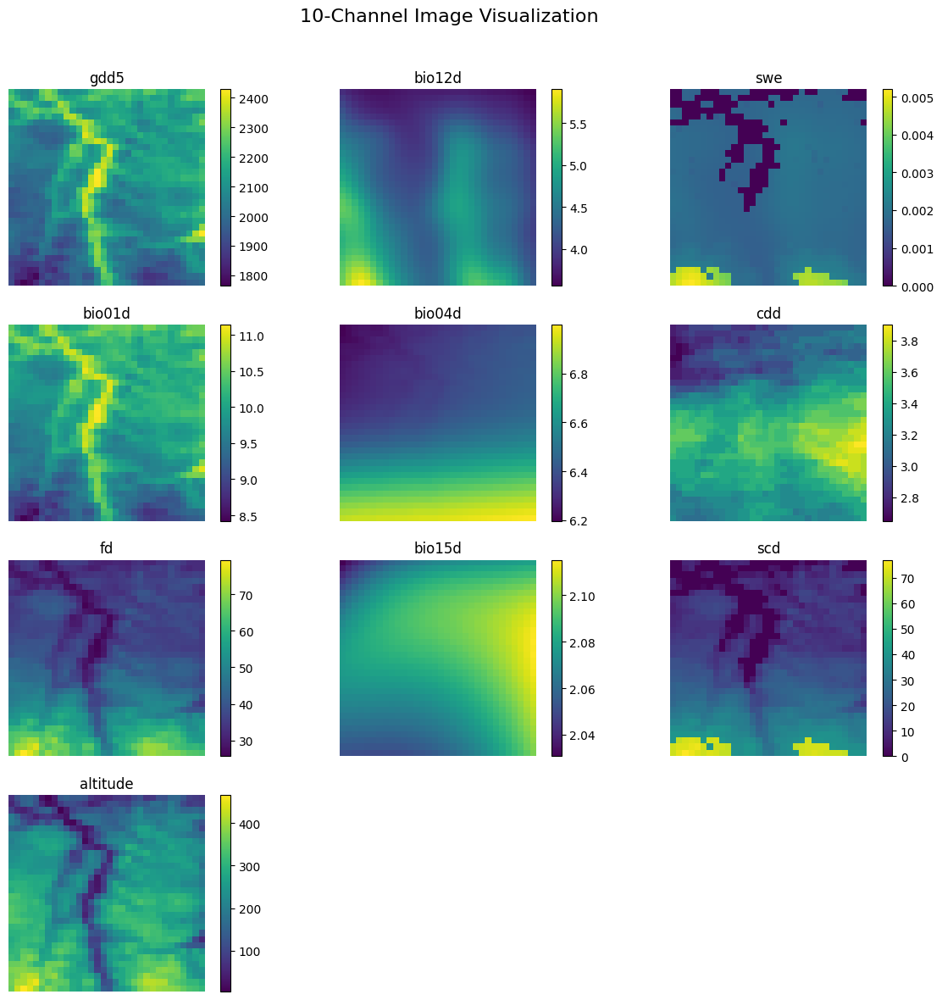

In [13]:
import numpy as np
import matplotlib.pyplot as plt

# Example 10-channel image (Replace with your actual data)
image_10ch = sampled_grids_climatic.iloc[44].climatic_map  # Shape (Height, Width, 10)

# Set up a 4-row, 3-column grid for 10 channels (12 slots total)
fig, axes = plt.subplots(4, 3, figsize=(12, 12))
fig.suptitle("10-Channel Image Visualization", fontsize=16)

# Flatten axes for easier indexing
axes = axes.flatten()

# Create a color map
cmap = plt.get_cmap("viridis")

# List of variable names
variable_names = variables.copy()  # Avoid modifying the original list
variable_names.append('altitude')  # Now length = 10

# Loop over the 10 channels
for i in range(10):
    ax = axes[i]
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)
    ax.set_title(f"{variable_names[i]}")
    ax.axis("off")
    fig.colorbar(img, ax=ax, orientation='vertical')

# Turn off the remaining unused subplots (slots 10 and 11)
for j in range(10, len(axes)):
    axes[j].axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
plt.show()


### Calculating species Richness

#### Loading Requirements

In [7]:
import json
import random

from tqdm import tqdm
import sys

import geopandas as gpd
from shapely.geometry import Point

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Import PyTorch
import torch
from torch import nn
import torch.optim as optim
import  torchvision.transforms as transforms

# Import torchvision 
import torchvision
from torchvision import datasets
from torchvision.transforms import ToTensor
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torchvision import models, transforms

In [8]:
seed = 42  # Choose any number

# Set seed for PyTorch
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)  # If using CUDA
torch.cuda.manual_seed_all(seed)  # If using multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Set seed for NumPy and Python's random module
np.random.seed(seed)
random.seed(seed)

In [9]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)

In [10]:
class MultiLabelDatasetRescale(Dataset):
    def __init__(self):
        # self.x_train, self.x_val, self.x_test, self.y_train, self.y_val, self.y_test = None, None, None, None, None, None
        self.mode = 'test'
        
         # Stack and convert to float32 tensor
        raw_images = torch.tensor(np.stack(df_2020_resampled['climatic_map'].values).astype(np.float32))  # shape: [N, H, W, C]
        # self.labels = torch.tensor(np.stack(df_2018_resampled['species_vector'].values).astype(np.float32))

        # Transpose to  [C, H, W] for PyTorch
        # raw_images = raw_images.permute(2, 0, 1)
        raw_images = raw_images.permute(0, 3, 1, 2)

                # === NORMALIZE EACH CHANNEL INDEPENDENTLY ===
        # These must match the order of your channels!

               # === NORMALIZE EACH CHANNEL INDEPENDENTLY ===
        # These must match the order of your channels!

        #2018
        # mins = torch.tensor([
        #     1.9000409841537476,          # gdd5
        #     0.9102739691734314,          # bio12d
        #     0.009359435178339481,         # swe
        #     -9.149993896484375,          # bio01d
        #     3.1500244140625,             # bio04d
        #     0.0,                         # cdd
        #     0.0,                         # fd
        #     1.0523613691329956,          # bio15d
        #     0.0,                         # scd
        #     0.0,                         # altitude
        # ])

        # maxs = torch.tensor([
        #     3858.301513671875, # gdd5
        #     21.650711059570312, #bio12d
        #     113.7122802734375, # swe
        #     10.45001220703125, #bio01d
        #     157.55001831054688, #bio04d
        #     8.0, #cdd
        #     362.0, # fd
        #     2.7762691974639893, #bio15d
        #     365.0, # scd
        #     2296.0, #altitude
        # ])

        # FUTURE HIRHAM5 2060-2080

        mins = torch.tensor([
            1.9000409841537476,          # gdd5
            0.9102739691734314,          # bio12d
            0.009359435178339481,         # swe
            -9.149993896484375,          # bio01d
            3.1500244140625,             # bio04d
            0.0,                         # cdd
            0.0,                         # fd
            1.0523613691329956,          # bio15d
            0.0,                         # scd
            0.0,                         # altitude
        ])

        maxs = torch.tensor([
            3858.301513671875, # gdd5
            21.650711059570312, #bio12d
            113.7122802734375, # swe
            11.1300, #bio01d
            157.55001831054688, #bio04d
            8.0, #cdd
            362.0, # fd
            2.7762691974639893, #bio15d
            365.0, # scd
            2296.0, #altitude
        ])
        

        # Avoid division by zero (e.g., for crs with constant 0)
        ranges = maxs - mins
        ranges[ranges == 0] = 1  # Prevent division by zero

        # Apply scaling: (x - min) / (max - min)
        # self.images = (raw_images - mins.view(-1, 1, 1)) / ranges.view(-1, 1, 1)

        
        self.images = (raw_images - mins.view(1, -1, 1, 1)) / ranges.view(1, -1, 1, 1)
        self.idx = df_2020_resampled.index.to_list()
        
    def __len__(self):
        if self.mode == 'test':
            
            return len(self.images)


    def __getitem__(self, idx):
        if self.mode == 'test':
            sample = {'images': self.images[idx], 'index': self.idx[idx]}

        return sample

In [11]:
import torch.nn.functional as F
import torch.distributed as dist
import argparse

class CustomLoss(nn.Module):
    def __init__(self, loss_fn, args):
        super(CustomLoss, self).__init__()
        self.loss_fn = loss_fn
        self.weighted = args.weighted
        self.args = args
        if self.weighted:
            self.samples_per_cls = list(args.train_label_cnt.values())
            self.no_of_classes = args.num_classes

    def compute_weights(self, labels, beta=0.9999):
        effective_num = 1.0 - np.power(beta, self.samples_per_cls)
        weights = (1.0 - beta) / np.array(effective_num)
        weights = weights / weights.sum() * self.no_of_classes
        labels_one_hot = labels

        weights = torch.tensor(weights).float().to(self.args.device, non_blocking=True)
        weights = weights.unsqueeze(0)
        weights = weights.repeat(labels_one_hot.shape[0],1) * labels_one_hot
        
        return weights
    
    def forward_focal(self, logits, labels,alpha=0.999,gamma=2.0):
        p = torch.sigmoid(logits)
        ce_loss = F.binary_cross_entropy_with_logits(logits, labels, reduction="none")
        p_t = p * labels + (1 - p) * (1 - labels)
        loss = ce_loss * ((1 - p_t) ** gamma)
        
        if self.weighted:
            weights = self.compute_weights(labels)
            weights_t = weights * labels * alpha + (1 - labels) * (1 - alpha)
            weighted_loss = weights_t * loss
            focal_loss = weighted_loss.mean()
        
        else:
            alpha_t = alpha * labels + (1 - alpha) * (1 - labels)
            focal_loss = alpha_t * loss
            focal_loss = focal_loss.mean()
        
        return focal_loss

    
    def forward_bce(self, logits, labels):
        if self.weighted:
            weights = self.compute_weights(labels)
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels, pos_weight = weights)
        else:
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels)
        
        return bce_loss
    
    
    def forward_dice(self, logits, labels):
        p = torch.sigmoid(logits)
        smooth = 1.0
        intersection = (p * labels).sum(0)
        total = (p**2 + labels**2).sum(0)
        dice_loss = 1 - (intersection + smooth)/(total + smooth)
        
        return dice_loss.mean()
    
    
    def forward(self, logits, labels):
        if self.loss_fn == 'bce':
            return self.forward_bce(logits, labels)
        elif self.loss_fn == 'focal':
            return self.forward_focal(logits, labels)
        elif self.loss_fn == 'dice':
            return self.forward_dice(logits, labels)

In [67]:
class CustomResNet18(nn.Module):
    def __init__(self, num_classes):
        super(CustomResNet18, self).__init__()

        # Load Pretrained ResNet18
        self.resnet = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
        
        # Replace ReLU activations with inplace=False to avoid in-place modification issues
        # self.resnet.relu = nn.ReLU(inplace=False)

        # Modify the first convolutional layer to accept 11 channels instead of 3
        self.resnet.conv1 = nn.Conv2d(10, 64, kernel_size=7, stride=2, padding=3, bias=False)

        # Access layers up to the last block of layer4
        # self.features_conv = self.resnet.layer4[-1]  # Excluding the last block in layer4
        self.hook = self.resnet.layer3[-1].conv2.register_forward_hook(self.hook_fn)
        self.activations = None

        # Modify the final fully connected layer to match the number of classes     
        self.in_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Linear(self.in_features, num_classes)

        # Freeze all layers initially
        for param in self.resnet.parameters():
            param.requires_grad = False

        # Placeholder for gradients
        self.gradients = None

    # Hook for capturing gradients during backward pass
    def activations_hook(self, grad):
        self.gradients = grad
        
    def hook_fn(self, module, input, output):
        # Store activations from the last convolutional layer
        self.activations = output
        
    # Forward pass through the network
    def forward(self, x):
        # Pass through the layers until the last convolutional block
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        # Register the hook on the output of the last convolutional layer (conv2 of the last block)
        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)
        
        # Register hook on the output of the last convolutional layer in layer4[1]
        x.requires_grad_()  # Enable gradient computation for this tensor
        h = x.register_hook(self.activations_hook)
        
        # Continue through the network
        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.resnet.fc(x)
        
        return x
    
    def get_embedding(self, x):
        # Forward pass up to avgpool
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)

        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)  # Shape: [batch_size, 2048]
        return x
    
    # Method to get the captured gradients
    def get_activations_gradient(self):
        return self.gradients

    # Method to get activations from the last convolutional layer (optional)
    def get_activations(self):
        return self.activations
    

#### Evaluating the model

In [68]:
# Load the NumPy array from the pickle file
# with open('../models/old_no_norm/thresholds_focal_RESNET18_49_tss_2017.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

with open('../models/thresholds_FOCAL_RESNET18_55_tss_1991-2018_FUTURE_full.pkl', 'rb') as f:
    loaded_thresholds = pickle.load(f)
global_threshold = np.mean(loaded_thresholds[np.isfinite(loaded_thresholds)])
global_threshold
# with open('../models/thresholds_BCE_60_tss.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

0.5155476

In [69]:
PATH = '../models/RESNET18_55_FOCAL_tss_1991-2018_FUTURE_full'
# PATH = '../models/old_no_norm/RESNET18_49_tss_2017'

In [70]:
num_classes = 1819
# device = torch.device('cuda:0')
device = torch.device('cuda:0')
MODEL = CustomResNet18(num_classes=num_classes).to(device)
# MODEL = CNNModel_1(11,32,num_classes).to(device)

# MODEL.load_state_dict(torch.load(PATH, weights_only=True)) # if GPU is available


MODEL.load_state_dict(torch.load(PATH, weights_only=True, map_location=torch.device(device)))
# model.to(args.device) 
MODEL.eval()

CustomResNet18(
  (resnet): ResNet(
    (conv1): Conv2d(10, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tr

In [71]:
with open('../data/species_counts_filtered_10_1991_2017.json', 'r') as f:
    class_counts_dict = json.load(f)

In [72]:
# Example args (you can replace it with your actual arguments)
class Args:
    def __init__(self):
        self.weighted = True  # Set to False if no class weighting is needed
        self.train_label_cnt = class_counts_dict  # Example class counts
        self.num_classes = 1819  # Binary classification
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.model_type = 'CNN'
        self.eval = False
        # self.thres_method = 'adaptive'
        self.thres_method = 'global'
        self.threshold = global_threshold

In [73]:
# Function to set the seed for each worker
def seed_worker(worker_id):
    # Set seed for Python and NumPy in each worker
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

In [74]:
with open(r'../data/Full_Scale/sampled_grids_bin_008_rcp85_2061-2080.pkl', "rb") as file_2:
    df_2020_resampled = pickle.load(file_2)
df_2020_resampled

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[2227.7507, 3.4913394, 0.0, 10.617701, 5.869..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[2233.3457, 3.4734678, 0.0, 10.632238, 5.884..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[2235.0356, 3.3721063, 0.0, 10.63069, 5.9128..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[2232.3506, 3.3680801, 0.0, 10.602335, 5.980..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[2229.133, 3.3661494, 0.0, 10.574531, 6.0402..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[1128.6268, 3.1166863, 0.007536549, 5.063225..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[1146.7069, 2.9778767, 0.007271239, 5.100388..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[1193.9469, 3.0844615, 0.007574909, 5.36403,..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[1118.7144, 2.9514394, 0.007292055, 4.822465..."


In [75]:

args = Args()
mlc_dataset = MultiLabelDatasetRescale()

print(len(mlc_dataset))
# mlc_dataset.train_val_test_split()
dataloader = DataLoader(mlc_dataset, batch_size = 32, shuffle = False, worker_init_fn=seed_worker)

11470


In [76]:
def species_vectors(model, eval_loader, criterion, thresholds, args):
    model.eval()
    # eval_loss = []
    all_preds = {}

    with torch.no_grad():
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # targets = batch['labels'].to(args.device, non_blocking=True)
            index = batch['index'].to(args.device, non_blocking=True)
            
            outputs = model(samples)
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())

            # Threshold logic
            if args.thres_method == 'adaptive':
                thresholds_tensor = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
            elif args.thres_method == 'global':
                thresholds_tensor = torch.tensor([args.threshold] * outputs.shape[1], dtype=torch.float32).to(args.device)
            else:
                raise ValueError("Unknown threshold method")

            probs = torch.sigmoid(outputs)
            preds = (probs >= thresholds_tensor).float()

            # Append each prediction individually to the list
            for i, pred in zip(index, preds):
                index_number = i.item()

                # print(index_number)
                all_preds[index_number] = pred.cpu().numpy()

    return all_preds

In [77]:
prob_dic = species_vectors(model = MODEL,eval_loader = dataloader, criterion = CustomLoss('focal', args), thresholds = loaded_thresholds, args = Args())


In [78]:
# Wrap each vector in a list so it stays in a single column
preds_df = pd.DataFrame({
    "predicted_vector": [v for v in prob_dic.values()]
}, index=prob_dic.keys())
preds_df

,predicted_vector
0,"[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...
11465,"[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11466,"[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11467,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
11468,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."


In [79]:
df_2020_with_preds = df_2020_resampled.join(preds_df, how='left')
df_2020_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[2227.7507, 3.4913394, 0.0, 10.617701, 5.869...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[2233.3457, 3.4734678, 0.0, 10.632238, 5.884...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[2235.0356, 3.3721063, 0.0, 10.63069, 5.9128...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[2232.3506, 3.3680801, 0.0, 10.602335, 5.980...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[2229.133, 3.3661494, 0.0, 10.574531, 6.0402...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[1128.6268, 3.1166863, 0.007536549, 5.063225...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[1146.7069, 2.9778767, 0.007271239, 5.100388...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[1193.9469, 3.0844615, 0.007574909, 5.36403,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[1118.7144, 2.9514394, 0.007292055, 4.822465...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."


In [80]:
def calculate_sp_richness(species_vectors):
    richness = []
    for i in species_vectors:
        nonzero = np.count_nonzero(i)
        richness.append(nonzero)
    return richness
# df_2018_with_preds['true_richness'] = calculate_sp_richness(df_2018_with_preds['species_vector'])    
df_2020_with_preds['predicted_richness'] = calculate_sp_richness(df_2020_with_preds['predicted_vector'])    
df_2020_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[2227.7507, 3.4913394, 0.0, 10.617701, 5.869...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",734
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[2233.3457, 3.4734678, 0.0, 10.632238, 5.884...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",722
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[2235.0356, 3.3721063, 0.0, 10.63069, 5.9128...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",753
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[2232.3506, 3.3680801, 0.0, 10.602335, 5.980...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",766
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[2229.133, 3.3661494, 0.0, 10.574531, 6.0402...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",768
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[1128.6268, 3.1166863, 0.007536549, 5.063225...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",511
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[1146.7069, 2.9778767, 0.007271239, 5.100388...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",438
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[1193.9469, 3.0844615, 0.007574909, 5.36403,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",851
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[1118.7144, 2.9514394, 0.007292055, 4.822465...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",773


In [81]:
def points_species_richness_plot(df, column_name):
    # Load the shapefile of Norway's boundaries
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Assuming 'df' contains your data with species richness in 'column_name' column
    # Step 1: Create GeoDataFrame from the DataFrame
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
     # ✅ Create new figure and axis
    fig, ax = plt.subplots(figsize=(8, 10))
    # Step 2: Plot the map
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Step 3: Plot the points with species richness as colors
    result_geo_df.plot(
        ax=ax, 
        column=column_name,  # Use the column passed to the function
        cmap='YlGnBu',  # Colormap for heatmap, you can try others like 'viridis', 'plasma', etc.
        markersize=3, 
        legend=True,  # Add legend for color scale
        alpha=0.7  # Make points slightly transparent for better visualization
    )
    
    # Customize plot
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.set_title(f"Predicted Species Richness in Norway 2061-2080", fontsize=15)
    plt.tight_layout()
    plt.savefig('../Images/SpeciesRichness_11000_samples_2061-2080.png')
    # Show the plots
    plt.show()

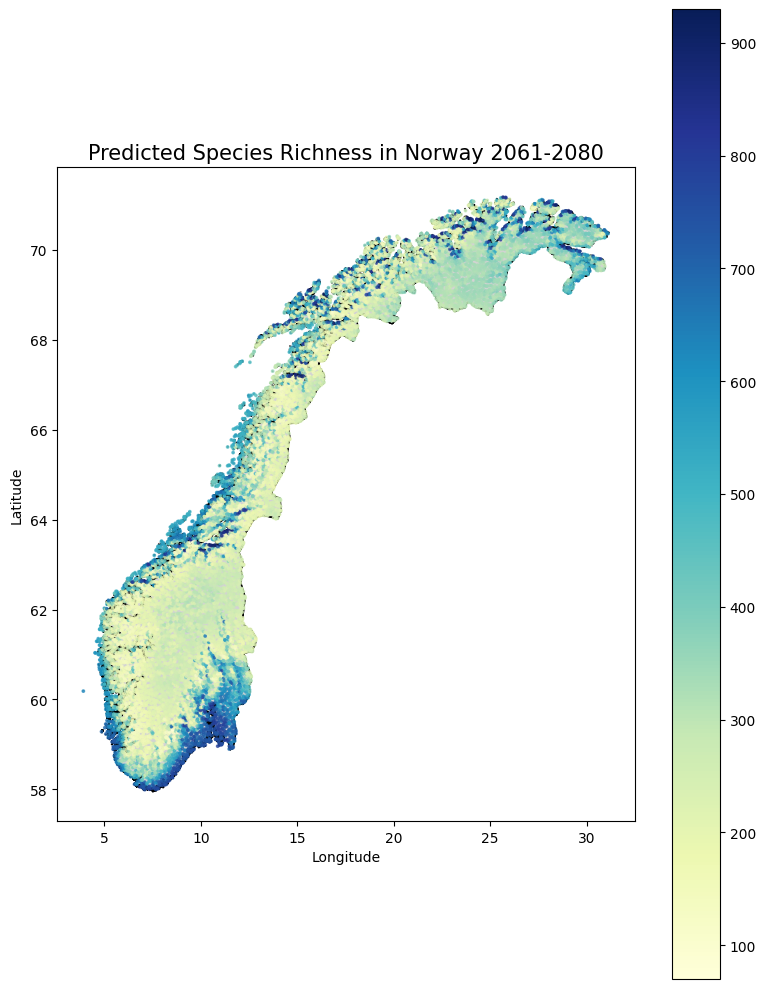

In [82]:
# Plot the predicted richness on the second subplot
points_species_richness_plot(df=df_2020_with_preds, column_name='predicted_richness')

### Redlisted SP Richness

In [83]:
# !pip install openpyxl
df_redlist = pd.read_excel(r'../data/interesting species.xlsx')
df_redlist

,Vitenskapelig navn,Autor,Populærnavn,Taksonomisk nivå,Kategori 2021,Distribution
0,Anacamptis morio,"(L.) R.M.Bateman, Pridgeon & M.W.Chase",narrmarihand,Art,CR,NaN
1,Anisantha sterilis,(L.) Nevski,sandfaks,Art,CR,NaN
2,Asperula tinctoria,L.,fargemyske,Art,CR,NaN
3,Blysmus compressus,(L.) Panz. ex Link,flatsivaks,Art,CR,NaN
4,Botrychium matricariifolium,(Retz.) A.Braum ex W.D.J.Koch,huldrenøkkel,Art,CR,NaN
...,...,...,...,...,...,...
1371,Berula erecta,(Huds.) Coville,vasskjeks,Art,VU,NaN
1372,Beta vulgaris,L.,bete,Art,VU,NaN
1373,Glaucium flavum,Crantz,gul hornvalmue,Art,VU,NaN
1374,Kali turgida,(Dumort.) Gutermann,sodaurt,Art,VU,NaN


In [84]:
# Filter rows where 'Kategori 2021' is CR, EN, or VU
redlisted_sp_df = df_redlist[df_redlist['Kategori 2021'].isin(['CR', 'EN', 'VU'])]
redlisted_species_list = redlisted_sp_df['Vitenskapelig navn'] 
redlisted_sp_df

,Vitenskapelig navn,Autor,Populærnavn,Taksonomisk nivå,Kategori 2021,Distribution
0,Anacamptis morio,"(L.) R.M.Bateman, Pridgeon & M.W.Chase",narrmarihand,Art,CR,NaN
1,Anisantha sterilis,(L.) Nevski,sandfaks,Art,CR,NaN
2,Asperula tinctoria,L.,fargemyske,Art,CR,NaN
3,Blysmus compressus,(L.) Panz. ex Link,flatsivaks,Art,CR,NaN
4,Botrychium matricariifolium,(Retz.) A.Braum ex W.D.J.Koch,huldrenøkkel,Art,CR,NaN
...,...,...,...,...,...,...
1371,Berula erecta,(Huds.) Coville,vasskjeks,Art,VU,NaN
1372,Beta vulgaris,L.,bete,Art,VU,NaN
1373,Glaucium flavum,Crantz,gul hornvalmue,Art,VU,NaN
1374,Kali turgida,(Dumort.) Gutermann,sodaurt,Art,VU,NaN


In [85]:
def points_redlisted_species_richness_plot(df, redlisted_species, species_universe):
    # Step 1: Get indices of redlisted species
    redlisted_indices = [species_universe[sp] for sp in redlisted_species if sp in species_universe]

    # Step 2: Compute red-listed richness per point
    df = df.copy()
    df["redlisted_richness"] = df["predicted_vector"].apply(
        lambda x: sum(x[i] for i in redlisted_indices)
    )

    # Step 3: Remove points with 0 redlisted richness
    df = df[df["redlisted_richness"] > 0]

    # Step 4: Make GeoDataFrame
    gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"
    )

    # Step 5: Plotting
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    fig, ax = plt.subplots(figsize=(8, 10))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    gdf.plot(
        ax=ax,
        column="redlisted_richness",
        cmap="Reds",
        markersize=3,
        legend=True,
        alpha=0.7
    )

    ax.set_title("Red_listed_Species_Richness_in Norway_2061_2080", fontsize=14)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    plt.tight_layout()
    plt.savefig(f"../Images/2061-2080_redlist_sp_in_Norway.png")
    plt.show()


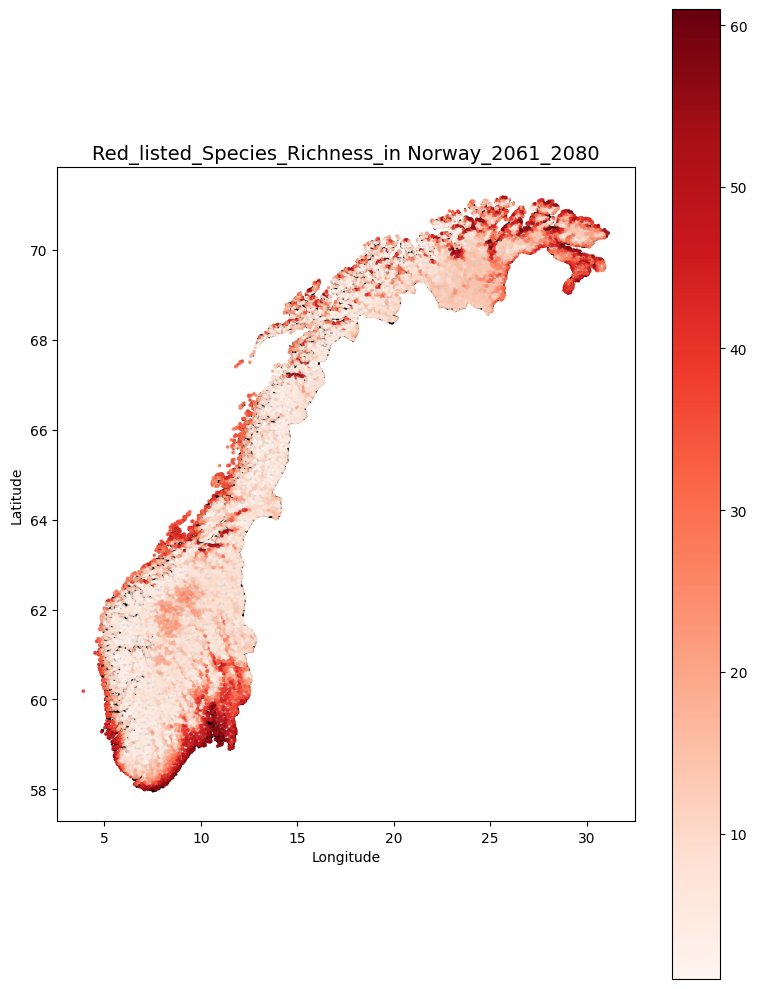

In [86]:
points_redlisted_species_richness_plot(df_2020_with_preds, redlisted_species_list, species_universe)

### Clustering Logits

In [87]:
# !pip install umap-learn
import umap.umap_ as umap
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [88]:
def umap_logits(model, eval_loader): 
    all_embeddings = []
    # all_labels = []
    all_indexes = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # labels = batch['labels'].to(args.device, non_blocking=True) 
            indexes = batch['index'].to(args.device, non_blocking=True)
            embeddings = model.get_embedding(samples)
            all_embeddings.append(embeddings.cpu().numpy())
            # all_labels.append(labels.cpu().numpy())
            all_indexes.append(indexes.cpu().numpy())
    # Convert to arrays
    X = np.vstack(all_embeddings)  # Shape: [N_samples, 2048]
    # y = np.concatenate(all_labels)
    ind = np.concatenate(all_indexes)
    reducer = umap.UMAP(n_components=3, random_state=42)
    X_umap = reducer.fit_transform(X)

    return X_umap, ind

In [89]:
umap, ind = umap_logits(model = MODEL,eval_loader = dataloader)

C:\Users\Raul\miniconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [90]:
ind

array([    0,     1,     2, ..., 11467, 11468, 11469], dtype=int64)

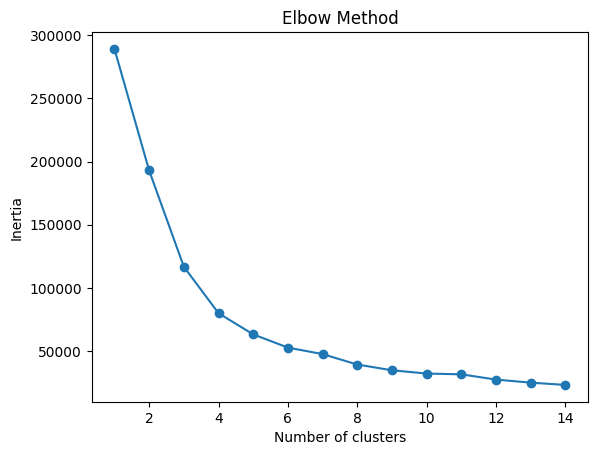

In [91]:
# Optional: Elbow method
inertia = []
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(umap)
    inertia.append(kmeans.inertia_)

plt.plot(range(1, 15), inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

In [92]:
number_clusters = 6

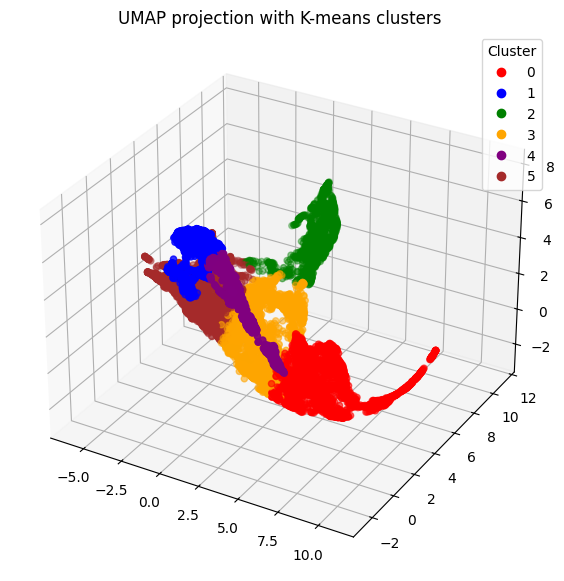

In [93]:
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap

# Fixed color map
fixed_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
fixed_cmap = ListedColormap(fixed_colors[:number_clusters])
# Final model with chosen K
kmeans = KMeans(n_clusters=number_clusters, random_state=42)
clusters = kmeans.fit_predict(umap)

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(umap[:, 0], umap[:, 1], umap[:, 2],
                     c=clusters, cmap=fixed_cmap, s=20)
ax.set_title("UMAP projection with K-means clusters")
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.savefig(f"../Images/k-means_2061-2080.png")
plt.show()


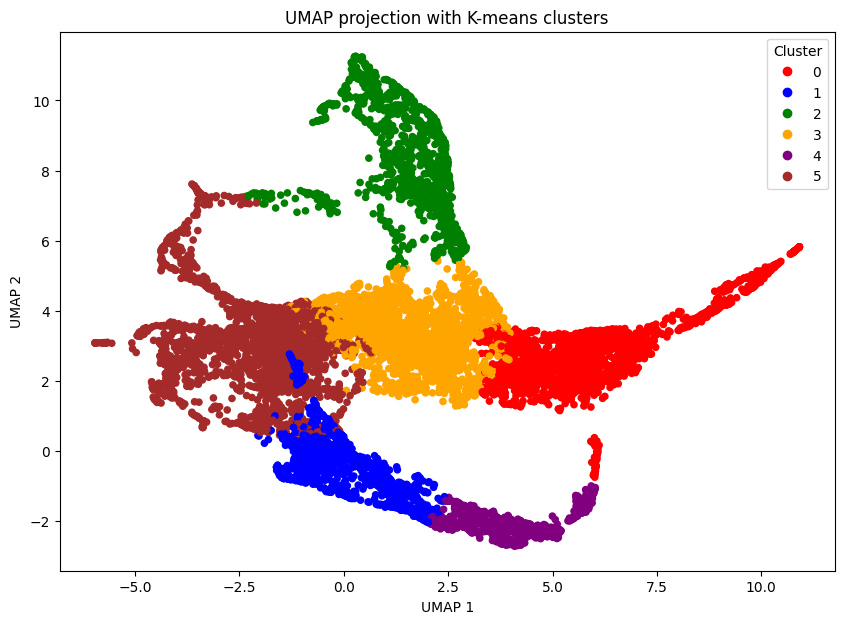

In [94]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

# Final model with chosen K
kmeans = KMeans(n_clusters=number_clusters, random_state=42)
clusters = kmeans.fit_predict(umap)

# 2D Plot
plt.figure(figsize=(10, 7))
scatter = plt.scatter(umap[:, 0], umap[:, 1],
                      c=clusters, cmap=fixed_cmap, s=20)
plt.title("UMAP projection with K-means clusters")
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.show()


In [95]:
# Creating umap DF
df_umap = pd.DataFrame(umap, columns=["UMAP1", "UMAP2", "UMAP3"])
df_umap["index"] = ind
df_umap["Cluster"] = clusters

In [96]:

import plotly.graph_objs as go

# Crear figura base
fig = go.Figure(
    data=[go.Scatter3d(
        x=df_umap["UMAP1"],
        y=df_umap["UMAP2"],
        z=df_umap["UMAP3"],
        mode='markers',
        marker=dict(
            size=3,
            color=df_umap["Cluster"],  # Numérico
            colorscale='Viridis',
            opacity=0.8
        ),
        text=df_umap["Cluster"].astype(str),
    )]
)

# Configuración general
fig.update_layout(
    scene=dict(
        xaxis_title='UMAP1',
        yaxis_title='UMAP2',
        zaxis_title='UMAP3'
    ),
    title="UMAP 3D with KMeans Clusters",
    margin=dict(l=0, r=0, b=0, t=30),
)

# No se agregan los frames ni la animación de rotación

fig.show()

# Guardar la figura
# fig.write_html(r"../docs/umap_3d_plot_no_rotate.html")




### Plotting UMAP on MAP

In [97]:
df_2020_with_clusters = df_umap.merge(
    df_2020_with_preds,
    left_on='index',      # 'index' column in df_umap
    right_index=True,     # index in df_2018_with_preds
    how='left'
)
df_2020_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,-0.552105,9.726905,3.294508,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[2227.7507, 3.4913394, 0.0, 10.617701, 5.869...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",734
1,-0.528908,9.719405,3.301410,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[2233.3457, 3.4734678, 0.0, 10.632238, 5.884...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",722
2,-0.531734,9.757256,3.320362,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[2235.0356, 3.3721063, 0.0, 10.63069, 5.9128...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",753
3,-0.519091,9.783716,3.340281,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[2232.3506, 3.3680801, 0.0, 10.602335, 5.980...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",766
4,-0.519035,9.775427,3.335643,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[2229.133, 3.3661494, 0.0, 10.574531, 6.0402...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",768
...,...,...,...,...,...,...,...,...,...,...,...
11465,-1.736377,0.865380,4.413578,11465,5,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[1128.6268, 3.1166863, 0.007536549, 5.063225...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",511
11466,-0.830742,0.340662,6.371622,11466,1,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[1146.7069, 2.9778767, 0.007271239, 5.100388...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",438
11467,-1.184467,2.465061,5.636254,11467,1,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[1193.9469, 3.0844615, 0.007574909, 5.36403,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",851
11468,-1.271291,2.142120,5.134053,11468,5,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[1118.7144, 2.9514394, 0.007292055, 4.822465...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",773


In [98]:
import matplotlib.pyplot as plt
import geopandas as gpd
import matplotlib.cm as cm
import matplotlib.colors as mcolors

def plotting_samples_norway_cluster(df):
    # Load Norway shapefile
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)

    # Create figure and axes
    fig, ax = plt.subplots(figsize=(10, 10))

    # Plot Norway outline
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    # Create GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"
    )

    # Get sorted unique cluster labels
    clusters = sorted(result_geo_df["Cluster"].unique())

    # Get viridis colormap with N discrete colors
    cmap = fixed_cmap
    colors = [cmap(i) for i in range(len(clusters))]
    cluster_to_color = dict(zip(clusters, colors))

    # Plot each cluster with its color
    for cluster_label in clusters:
        cluster_df = result_geo_df[result_geo_df["Cluster"] == cluster_label]
        cluster_df.plot(
            ax=ax,
            markersize=3,
            label=f"Cluster {cluster_label}",
            color=cluster_to_color[cluster_label],
            alpha=0.8
        )

    # Customize plot
    ax.set_title("Clusterized Bioclimatic regions 2061-2080", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend(title="Cluster", loc="lower right", markerscale=6)
    plt.savefig(f"../Images/2061-2080_bioclimatic_regions_in_Norway.png")

    plt.show()


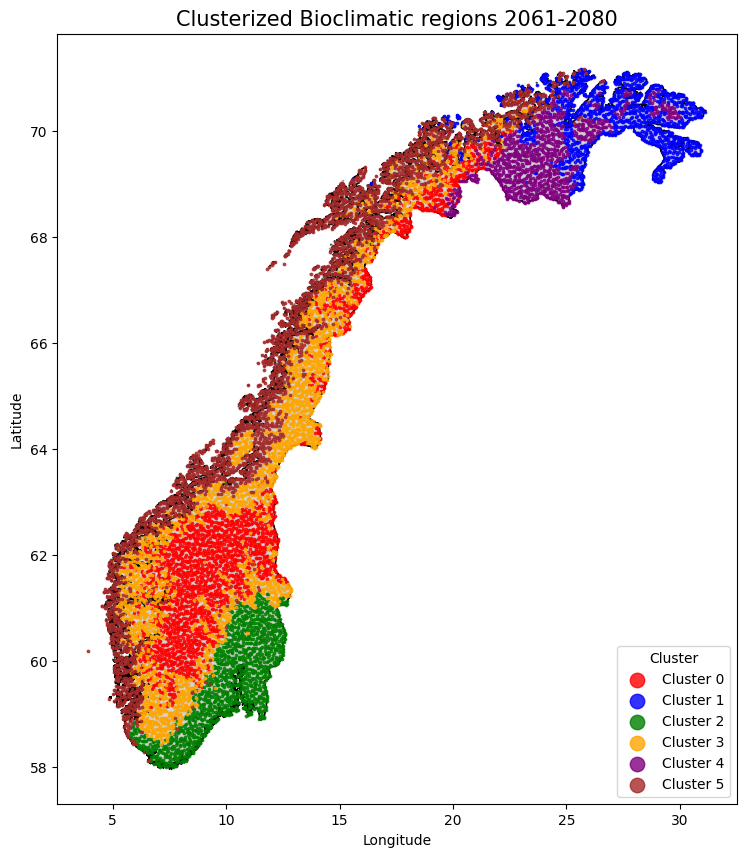

In [99]:
plotting_samples_norway_cluster(df_2020_with_clusters)

Est - west gradient is very strong due to the oceanic influence.

In [100]:
df_2020_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,-0.552105,9.726905,3.294508,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[2227.7507, 3.4913394, 0.0, 10.617701, 5.869...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",734
1,-0.528908,9.719405,3.301410,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[2233.3457, 3.4734678, 0.0, 10.632238, 5.884...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",722
2,-0.531734,9.757256,3.320362,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[2235.0356, 3.3721063, 0.0, 10.63069, 5.9128...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",753
3,-0.519091,9.783716,3.340281,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[2232.3506, 3.3680801, 0.0, 10.602335, 5.980...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",766
4,-0.519035,9.775427,3.335643,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[2229.133, 3.3661494, 0.0, 10.574531, 6.0402...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",768
...,...,...,...,...,...,...,...,...,...,...,...
11465,-1.736377,0.865380,4.413578,11465,5,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[1128.6268, 3.1166863, 0.007536549, 5.063225...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",511
11466,-0.830742,0.340662,6.371622,11466,1,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[1146.7069, 2.9778767, 0.007271239, 5.100388...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",438
11467,-1.184467,2.465061,5.636254,11467,1,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[1193.9469, 3.0844615, 0.007574909, 5.36403,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",851
11468,-1.271291,2.142120,5.134053,11468,5,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[1118.7144, 2.9514394, 0.007292055, 4.822465...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",773


In [101]:
import pandas as pd
import numpy as np

# Assuming 'df' is your DataFrame containing the data with the 'climatic_map' column

# Define a function to calculate the mean per channel
def extract_mean_climatic_map(df):
    # Initialize an empty list to store the results
    mean_values = []

    # Iterate over each row in the dataframe
    for idx, row in df.iterrows():
        # Flatten the climatic_map (assuming it's a list of lists of lists)
        climatic_map = np.array(row['climatic_map'])

        # Compute the mean of the values per channel (assuming each column in the map corresponds to a channel)
        mean_per_channel = climatic_map.mean(axis=(0, 1))  # Mean over the first two dimensions (rows and columns of the map)

        # Store the means for each row
        mean_values.append(mean_per_channel)
        
    variables_list =['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd','alt']


    # Add the mean values as new columns to the dataframe
    mean_values_df = pd.DataFrame(mean_values, columns=[f"{variables_list[i]}" for i in range(mean_values[0].shape[0])])

    # Concatenate the new mean columns to the original dataframe (excluding 'geometry' column)
    df_with_means = pd.concat([df.drop(columns=['geometry']), mean_values_df], axis=1)
    return df_with_means

# Now group by Cluster and calculate the mean for each cluster
df_with_means = extract_mean_climatic_map(df_2020_with_clusters)

# Group by 'Cluster' and calculate the mean of each channel, excluding non-numeric columns
grouped_means = df_with_means.drop(columns=['index','latitude', 'longitude', 'predicted_vector', 'predicted_richness']).groupby('Cluster').mean()




In [102]:
df_with_means

,UMAP1,UMAP2,UMAP3,index,Cluster,latitude,longitude,climatic_map,predicted_vector,predicted_richness,gdd5,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
0,-0.552105,9.726905,3.294508,0,2,58.028287,6.997755,"[[[2227.7507, 3.4913394, 0.0, 10.617701, 5.869...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",734,2228.819336,3.926997,0.000002,10.616028,5.873325,2.611379,24.382969,1.918817,0.002930,39.381836
1,-0.528908,9.719405,3.301410,1,2,58.022171,7.050138,"[[[2233.3457, 3.4734678, 0.0, 10.632238, 5.884...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",722,2221.399170,3.861087,0.000002,10.577431,5.925683,2.623096,25.274096,1.933646,0.003906,39.798828
2,-0.531734,9.757256,3.320362,2,2,57.990907,7.086381,"[[[2235.0356, 3.3721063, 0.0, 10.63069, 5.9128...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",753,2216.509033,3.711601,0.000013,10.552331,5.960155,2.731788,25.911594,1.945782,0.038086,28.430664
3,-0.519091,9.783716,3.340281,3,2,58.026571,7.219693,"[[[2232.3506, 3.3680801, 0.0, 10.602335, 5.980...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",766,2185.970215,3.750623,0.000259,10.396947,6.134963,2.758008,29.613169,1.998628,1.463867,62.408203
4,-0.519035,9.775427,3.335643,4,2,58.029728,7.285729,"[[[2229.133, 3.3661494, 0.0, 10.574531, 6.0402...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",768,2187.782471,3.707343,0.000394,10.378631,6.215027,2.839843,30.992252,2.020991,2.134766,65.273438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11465,-1.736377,0.865380,4.413578,11465,5,71.160690,25.549503,"[[[1128.6268, 3.1166863, 0.007536549, 5.063225...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",511,1116.242065,2.765081,0.006938,4.841745,7.359445,1.425585,135.140213,1.769953,115.338867,70.623047
11466,-0.830742,0.340662,6.371622,11466,1,71.160205,25.621730,"[[[1146.7069, 2.9778767, 0.007271239, 5.100388...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",438,1121.833618,2.732719,0.006790,4.829400,7.409998,1.472023,135.831909,1.797846,115.497070,82.509766
11467,-1.184467,2.465061,5.636254,11467,1,71.175275,25.662772,"[[[1193.9469, 3.0844615, 0.007574909, 5.36403,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",851,1122.659668,2.678041,0.006629,4.806046,7.441586,1.482862,136.545929,1.810129,115.729492,73.997070
11468,-1.271291,2.142120,5.134053,11468,5,71.166685,25.790593,"[[[1118.7144, 2.9514394, 0.007292055, 4.822465...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",773,1132.579956,2.735631,0.006598,4.802181,7.513169,1.416063,137.207809,1.805199,115.832031,64.622070


In [103]:
# Show the result
grouped_means

,UMAP1,UMAP2,UMAP3,climatic_map,gdd5,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
Cluster,,,,,,,,,,,,,,
0,5.899627,2.846213,-0.669068,"[[[1020.7095, 4.419891, 0.009331222, 3.0705645...",1008.139587,4.381166,0.009559,2.979094,8.496287,1.731344,180.302979,1.666406,135.709808,955.379333
1,-0.010566,-0.382660,6.716876,"[[[1196.2504, 2.328931, 0.003696745, 4.1085653...",1184.426758,2.349182,0.003919,4.161439,8.579075,1.533515,153.527084,2.037155,120.330460,185.194626
2,1.411946,8.379560,3.463008,"[[[2120.2534, 3.065187, 0.0014690863, 9.194702...",2072.106201,3.149224,0.001653,8.934916,8.033034,4.353252,82.132668,2.208757,75.112137,258.381470
3,1.556607,3.304960,0.385847,"[[[1246.2732, 6.115809, 0.011078543, 5.027142,...",1232.755981,6.075786,0.011242,4.954310,7.939726,1.957183,139.978943,1.652442,110.459343,578.839417
4,4.247183,-2.016690,5.547987,"[[[1117.0637, 2.2494478, 0.0031327705, 3.15632...",1100.676392,2.307367,0.003461,3.093889,9.127016,1.557061,172.837891,1.996392,129.443954,475.687286
5,-2.073041,2.962092,2.177746,"[[[1360.8678, 5.4718723, 0.009359802, 6.052504...",1357.016113,5.517085,0.009285,6.069064,7.302626,1.827308,109.093529,1.605644,90.131439,149.059372


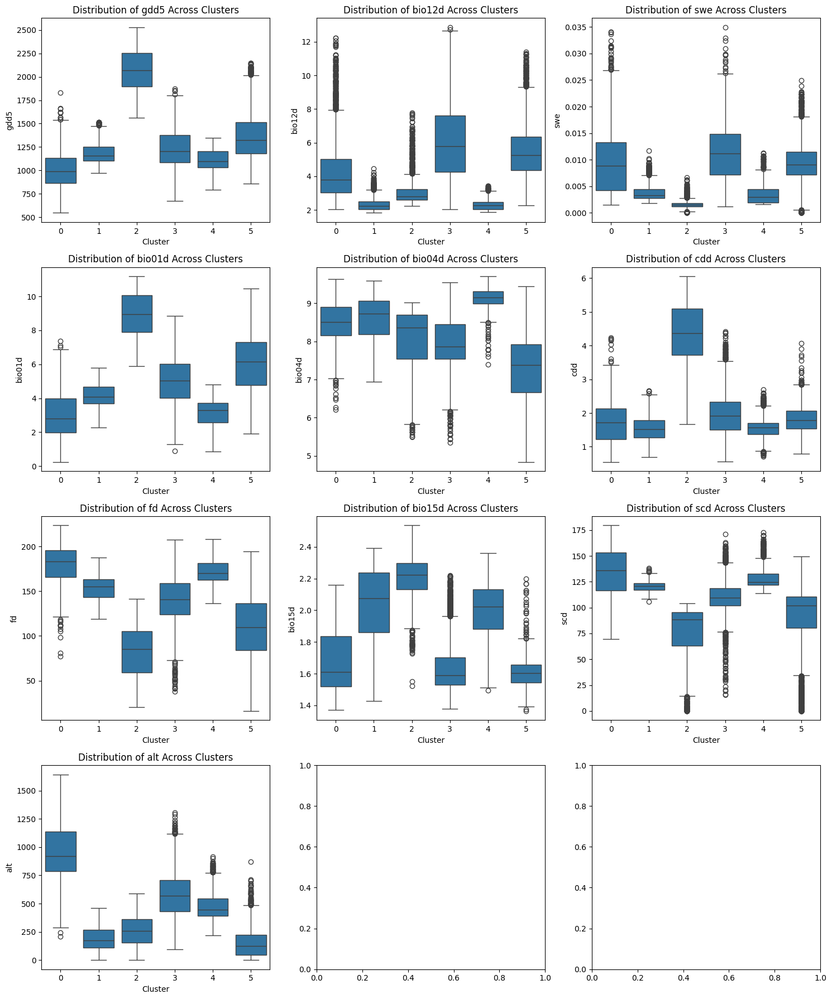

In [104]:
# List of variables
variables = ['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'alt']

# Create a figure and axes for the boxplots
fig, axes = plt.subplots(4, 3, figsize=(15, 18))  # 4 rows and 3 columns for a total of 12 plots
axes = axes.flatten()  # Flatten to easily index the axes

# Loop over each variable and create a boxplot
for i, var in enumerate(variables):
    sns.boxplot(x='Cluster', y=var, data=df_with_means, ax=axes[i])
    axes[i].set_title(f'Distribution of {var} Across Clusters')
    axes[i].set_xlabel('Cluster')
    axes[i].set_ylabel(var)

# Adjust layout
plt.tight_layout()
plt.show()

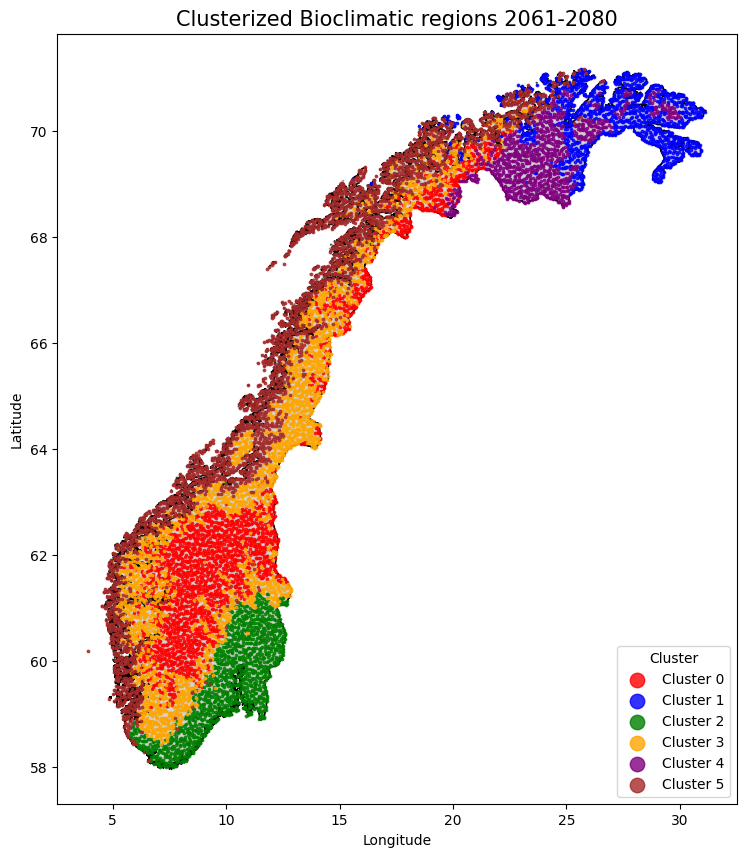

In [105]:
plotting_samples_norway_cluster(df_2020_with_clusters)

### Integrated Gradients

In [48]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)
# Filter for Salix species and get their indexes
salix_indexes = {species: index for species, index in species_universe.items() if species.lower().startswith('salix')}

# Show the result
print(salix_indexes)

{'Salix myrsinifolia': 175, 'Salix polaris': 243, 'Salix myrtilloides': 411, 'Salix phylicifolia': 419, 'Salix smithiana': 569, 'Salix lanata': 656, 'Salix viminalis': 663, 'Salix arbuscula': 739, 'Salix pentandra': 786, 'Salix daphnoides': 793, 'Salix hastata': 838, 'Salix gmelinii': 847, 'Salix starkeana': 912, 'Salix caprea': 987, 'Salix lapponum': 996, 'Salix reticulata': 1060, 'Salix myrsinites': 1176, 'Salix meyeriana': 1222, 'Salix alba': 1257, 'Salix repens': 1337, 'Salix fragilis': 1341, 'Salix purpurea': 1417, 'Salix glauca': 1510, 'Salix triandra': 1553, 'Salix cinerea': 1559, 'Salix aurita': 1730, 'Salix herbacea': 1795}


In [53]:
def extract_position(model, eval_loader, name, criterion,thresholds,args): 
    selected_images = []
    sp_index = species_universe[name]
    # eval_loss = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            outputs = model(samples)
                
            # targets = batch['labels'].to(args.device, non_blocking=True)            
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())
            
            if args.thres_method == 'adaptive':
                # thresholds = torch.load(args.output_dir.joinpath('thresholds_train.pth'))
                thresholds = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
                # thresholds = torch.tensor(thresholds).to(args.device)
            elif args.thres_method == 'global':
                thresholds = args.threshold
            
            prob = torch.sigmoid(outputs) >= thresholds
            # label = targets >= thresholds
            
            # print('prob',prob)
            # print('prob shape',prob.shape)

            # print('label',label)
            # print(samples.shape[0])
            # Go through the batch
            for i in range(samples.shape[0]):
                if prob[i][sp_index]:
                    selected_images.append(samples[i].cpu())  



        # eval_loss = torch.tensor(eval_loss).mean().item()

        return selected_images
    

In [54]:
selected_images = extract_position(model = MODEL,eval_loader = dataloader,
                          name = 'Salix reticulata', 
                          criterion = CustomLoss('focal', args), 
                          thresholds = loaded_thresholds, 
                          args = Args())

In [55]:
len(selected_images),selected_images

(5522,
 [tensor([[[0.3044, 0.2792, 0.2605,  ..., 0.2236, 0.2174, 0.2121],
           [0.3130, 0.2938, 0.2828,  ..., 0.2255, 0.2191, 0.2163],
           [0.3183, 0.2952, 0.2719,  ..., 0.2305, 0.2315, 0.2287],
           ...,
           [0.1893, 0.1875, 0.1796,  ..., 0.2215, 0.2220, 0.2265],
           [0.1866, 0.1833, 0.1770,  ..., 0.2261, 0.2105, 0.1924],
           [0.2299, 0.2190, 0.2012,  ..., 0.2407, 0.2323, 0.2309]],
  
          [[0.3072, 0.3170, 0.3285,  ..., 0.2840, 0.2861, 0.2890],
           [0.3080, 0.3140, 0.3221,  ..., 0.2834, 0.2857, 0.2881],
           [0.3088, 0.3143, 0.3236,  ..., 0.2811, 0.2810, 0.2831],
           ...,
           [0.3224, 0.3228, 0.3272,  ..., 0.2960, 0.2825, 0.2694],
           [0.3234, 0.3240, 0.3276,  ..., 0.2869, 0.2797, 0.2752],
           [0.3154, 0.3178, 0.3223,  ..., 0.2733, 0.2659, 0.2578]],
  
          [[0.1559, 0.1617, 0.1664,  ..., 0.1493, 0.1511, 0.1806],
           [0.1568, 0.1598, 0.1632,  ..., 0.1486, 0.1501, 0.1518],
           [0.1

In [56]:
# !pip install captum
from captum.attr import IntegratedGradients

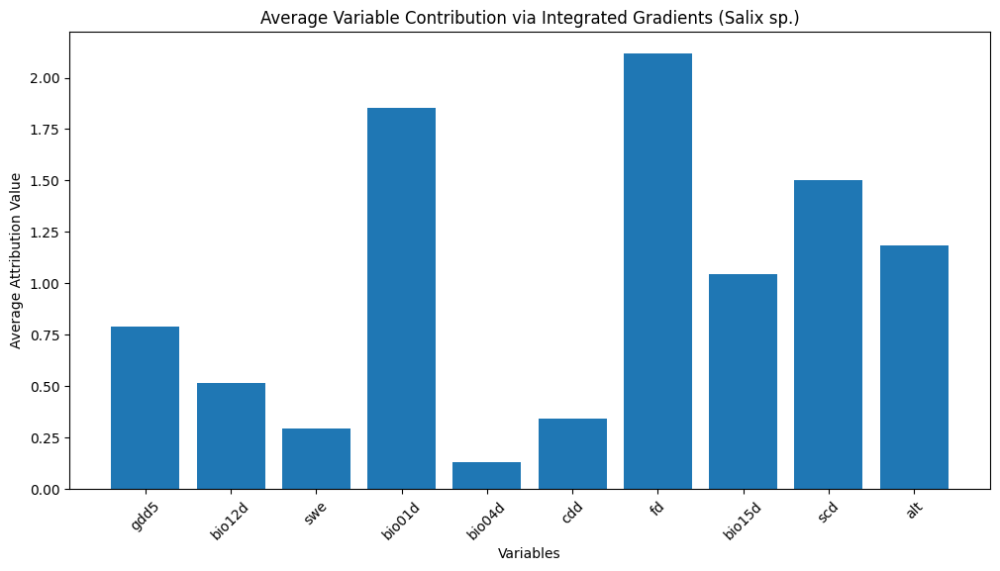

In [57]:
### Modificar para que printe ya directamente en la imagen el titulo de la target Sp

# Move the model to CPU (if it is on GPU)
MODEL = MODEL.to('cpu')

# Assuming selected_images is the list of images from your function
images_tensor = torch.stack(selected_images).to('cpu')  # Move to CPU

# List to store the attribution values for each image
all_channel_attributions = []
ig = IntegratedGradients(MODEL)

x = 0
# Loop through each image one by one
for img in selected_images:
    # Move the image to the correct device
    img_tensor = img.unsqueeze(0).to('cpu')  # Add batch dimension and move to device
    img_tensor.requires_grad_() # recomputar grafico con ordenador xavier
    # Calculate the attribution for the image (target the specific species index, e.g., 1060 for Salix)
    attributions, delta = ig.attribute(img_tensor, target=[1060], return_convergence_delta=True)

    # Aggregate the attribution by summing over height and width
    channel_attributions = torch.sum(torch.abs(attributions), dim=(2, 3))  # Sum over height and width for each channel

    # Convert to numpy and store it
    all_channel_attributions.append(channel_attributions.detach().cpu().numpy())
    x+=1
    # print(f'image {x} computed')

# Convert the list to a numpy array for easier averaging
all_channel_attributions = np.array(all_channel_attributions)

# Calculate the average attribution across all images (axis 0 is the batch dimension)
average_attributions = np.mean(all_channel_attributions, axis=0)

# Plot the average attribution values for each channel
plt.figure(figsize=(12, 6))
plt.bar(range(len(average_attributions[0])), average_attributions[0], tick_label=variables)
plt.title('Average Variable Contribution via Integrated Gradients (Salix sp.)')
plt.xlabel('Variables')
plt.xticks(rotation=45)
plt.ylabel('Average Attribution Value')
plt.show()



We can see that for salix reticulata the most important variables are the frost days (fd), the mean annual air temperature (bio01d) and the snow cover days (scd) as it is a specie that lives on alpine exposed areas with low snow accumulation.

### Plotting 1 species distribution

In [106]:
def plotting_one_species_distribution_norway(df, sp_name):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Get the index of the species in the species_universe
    index = species_universe[sp_name]
    
    # Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
    mask = df['predicted_vector'].apply(lambda x: x[index] == 1)  # Check if species is present in predicted_vector
    
    # Apply the mask to filter the DataFrame
    filtered_df = df[mask]
    filtered_df
    
    # Step 3: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Convert the filtered DataFrame into a GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        filtered_df, 
        geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points where the species is present
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label=f"{sp_name} Presence")
    
    # Customize plot
    ax.set_title(f"{sp_name} Distribution in Norway 2061-2080", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    
    # Show the plot
    plt.show()

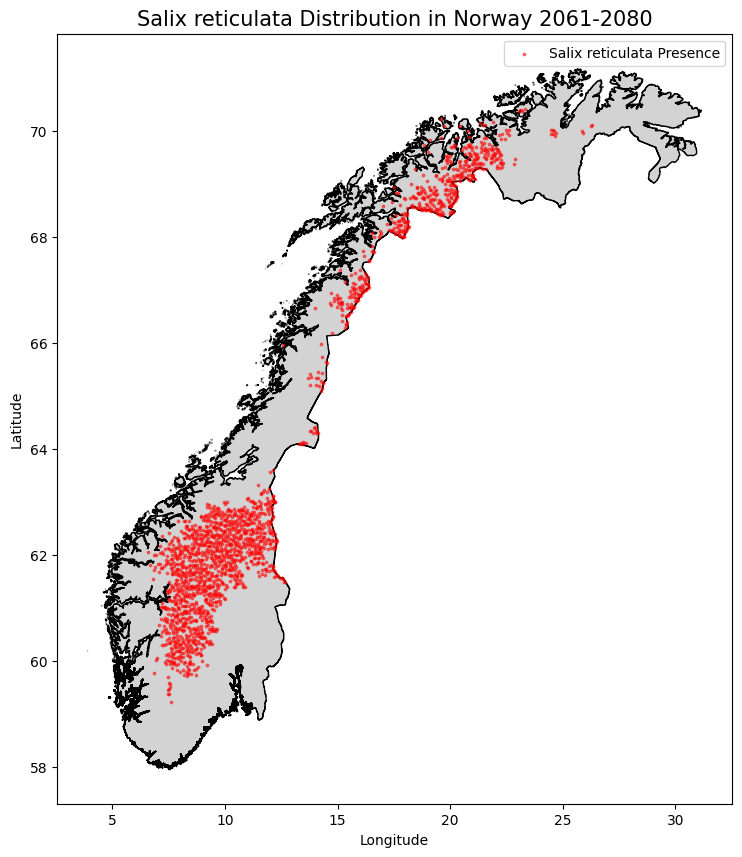

In [107]:
plotting_one_species_distribution_norway(df_2020_with_preds,'Salix reticulata')

### Plotting Multiple Species Distributions

In [108]:
def plotting_multiple_species_distribution_norway(df, species_list,tipo):    
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    
    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    colors = plt.get_cmap("tab10", len(species_list))  # Get distinct colors
    
    for i, sp_name in enumerate(species_list):
        index = species_universe[sp_name]
        mask = df['predicted_vector'].apply(lambda x: x[index] == 1)
        filtered_df = df[mask]

        result_geo_df = gpd.GeoDataFrame(
            filtered_df, 
            geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
            crs="EPSG:4326"
        )
        result_geo_df.plot(
            ax=ax,
            markersize=3,
            # color=colors(i),
            color='red',
            alpha=0.6,
            label=sp_name
        )

    ax.set_title(f"{tipo }Species Distributions in Norway", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    # ax.legend(markerscale=2)
    plt.show()


In [109]:
alpine_sp_list = ['Salix lanata', 'Salix polaris', 'Betula nana',
                  'Harrimanella hypnoides', 'Micranthes stellaris', 
                  'Oxyria digyna', 
                  'Sibbaldia procumbens', 'Ranunculus glacialis'] #  'Minuartia biflora','Juncus trifidus'

treeline_sp_list = ['Picea abies','Betula pubescens','Pinus sylvestris',
                    'Salix caprea','Alnus incana', 
                    'Lathyrus linifolius', 'Knautia arvensis', 'Prunus padus'] #'Linnea borealis',

len(alpine_sp_list),len(treeline_sp_list)

(8, 8)

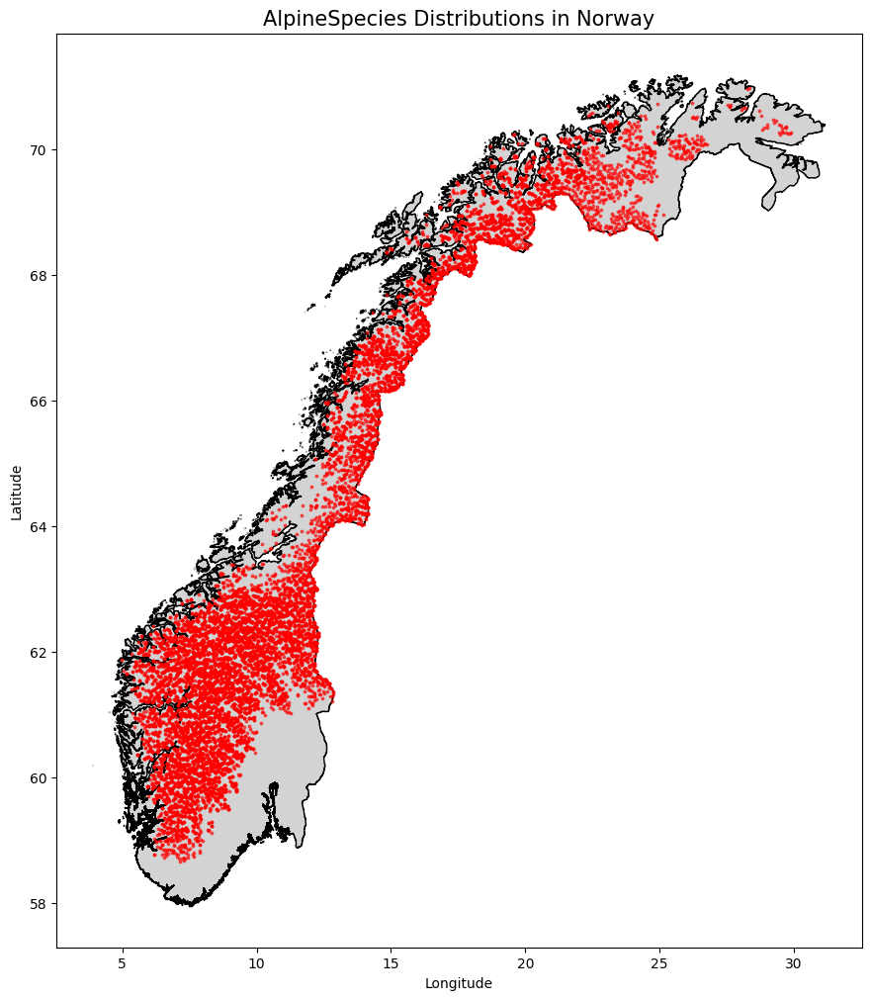

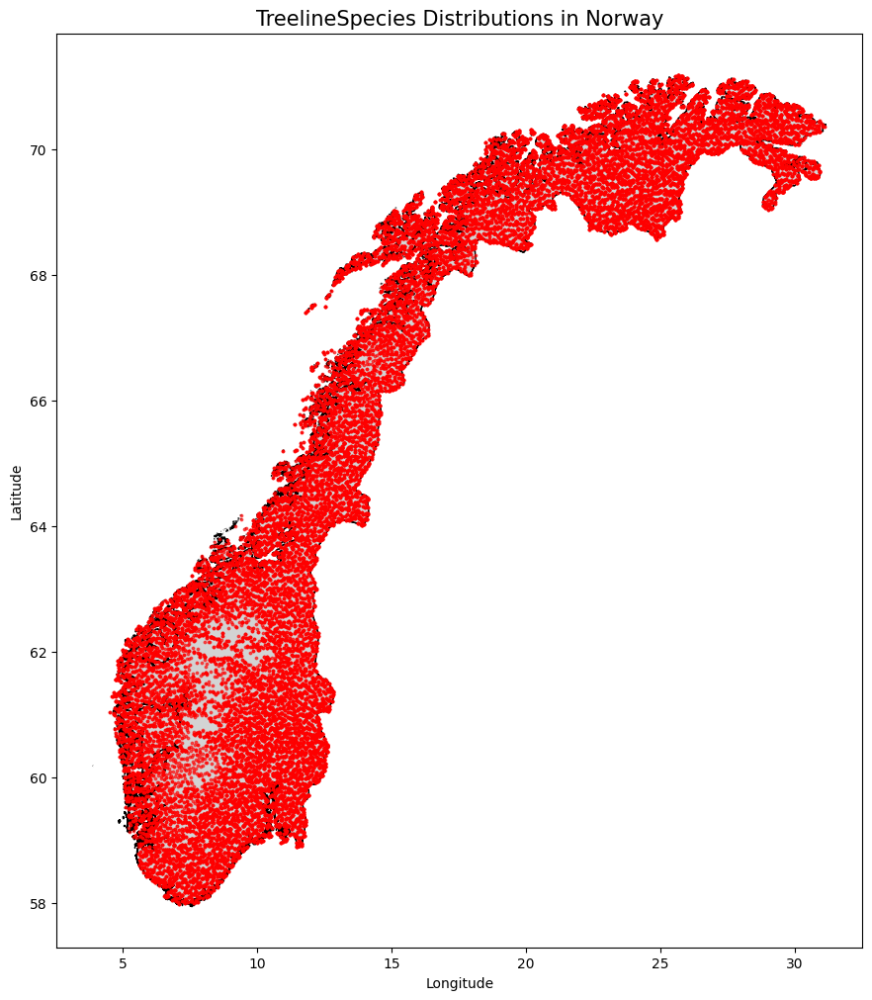

In [110]:

plotting_multiple_species_distribution_norway(df_2020_with_preds,alpine_sp_list,'Alpine')

plotting_multiple_species_distribution_norway(df_2020_with_preds,treeline_sp_list,'Treeline')

### Multiple Species Co-Ocurrence

In [111]:
def plotting_multiple_species_coocurrence_distribution_norway(df, species_list, tipo):    
    # Load Norway boundaries
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    
    # Get the list of species indices
    indices = [species_universe[sp_name] for sp_name in species_list]
    
    # Create a mask: rows where ALL species are present (i.e., value == 1 for all indices)
    mask = df['predicted_vector'].apply(lambda x: sum(x[i] == 1 for i in indices) >= 3)
    
    # Filter the DataFrame using the mask
    filtered_df = df[mask]
    
    # Create a GeoDataFrame from the filtered data
    result_geo_df = gpd.GeoDataFrame(
        filtered_df, 
        geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
        crs="EPSG:4326"
    )

    # Plotting
    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    result_geo_df.plot(
        ax=ax,
        markersize=3,
        color='red',
        alpha=0.6,
        label=f"All species: {', '.join(species_list)}"
    )

    ax.set_title(f"Simultaneous Distribution of Species in Norway ({tipo})", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    # ax.legend()
    plt.show()


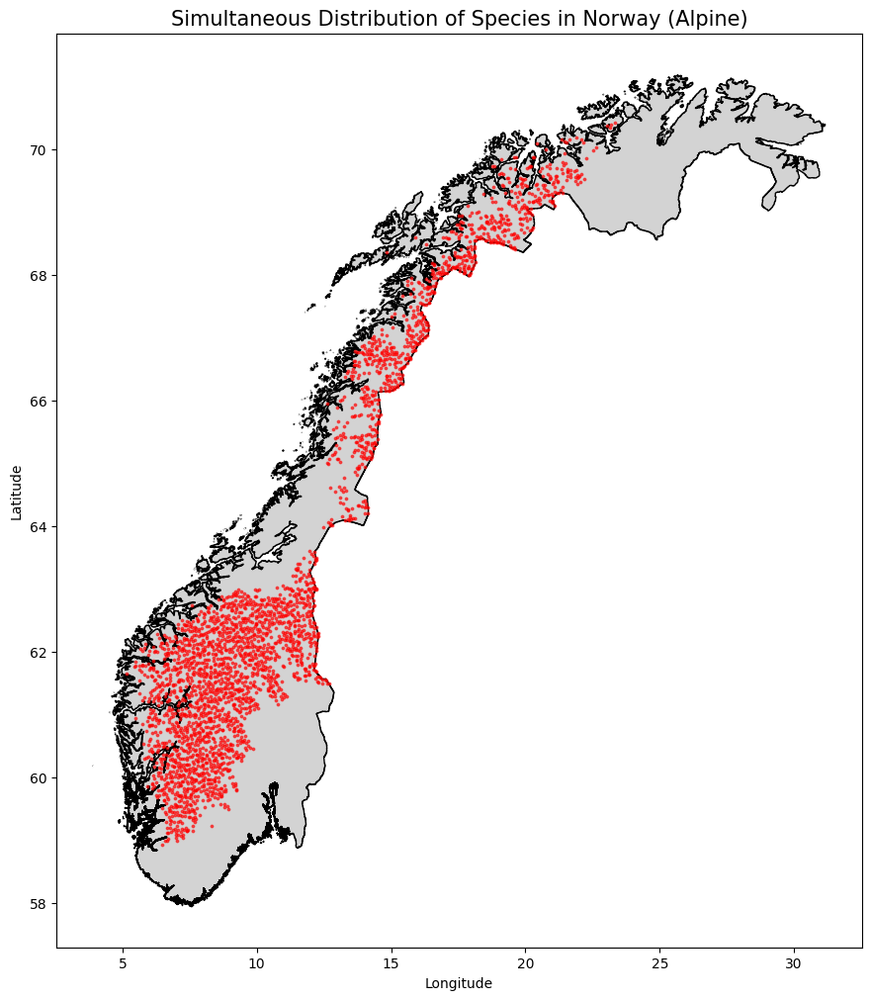

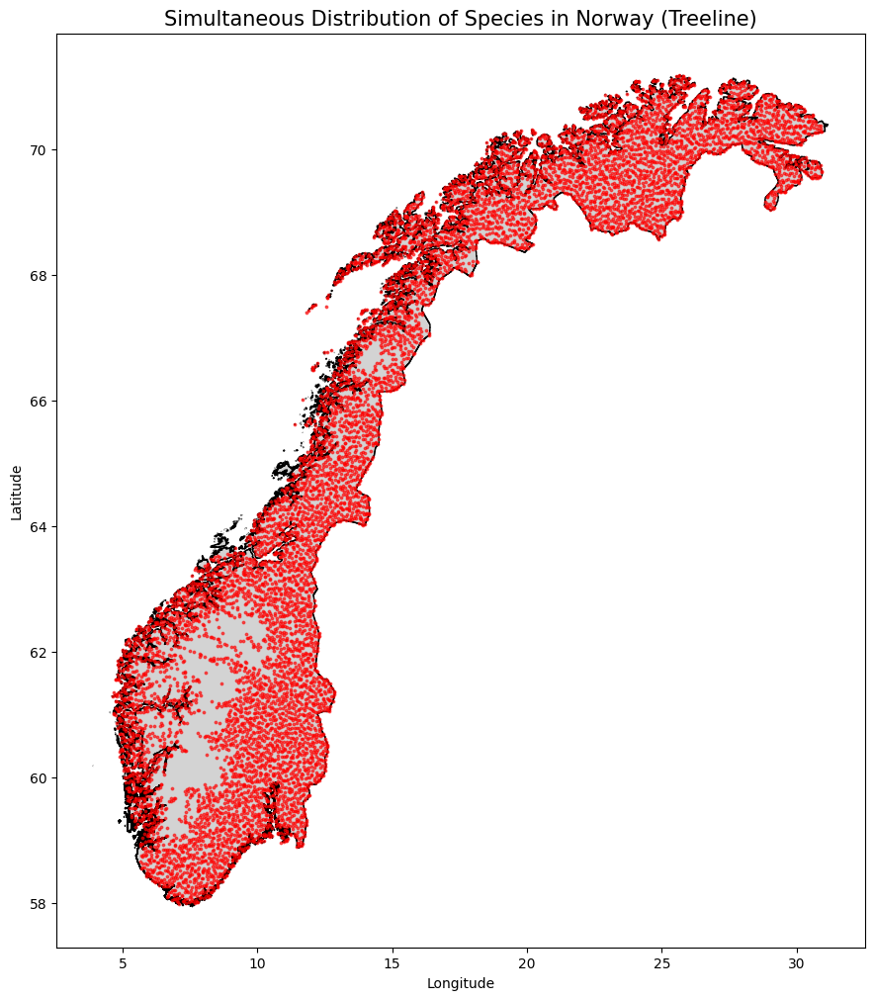

In [112]:

plotting_multiple_species_coocurrence_distribution_norway(df_2020_with_preds,alpine_sp_list,'Alpine')

plotting_multiple_species_coocurrence_distribution_norway(df_2020_with_preds,treeline_sp_list,'Treeline')

### Combined Plot

In [115]:
def plot_combined_species_groups(df, alpine_species, treeline_species, tipo="Combined"):

    # Load Norway shapefile
    norway = gpd.read_file("../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)

    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    # Process both groups
    for group_name, species_list, color in [
        ("Alpine", alpine_species, "blue"),
        ("Treeline", treeline_species, "green")
    ]:
        # Get indices
        indices = [species_universe[sp] for sp in species_list]

        # Keep only rows where ALL species in this group are present
        mask = df['predicted_vector'].apply(lambda x: sum(x[i] == 1 for i in indices) >= 3)
        filtered_df = df[mask]

        # Convert to GeoDataFrame
        geo_df = gpd.GeoDataFrame(
            filtered_df,
            geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
            crs="EPSG:4326"
        )

        # Plot
        geo_df.plot(ax=ax, markersize=4, color=color, alpha=0.6, label=f"{group_name} spp. ({len(geo_df)})")

    # Final plot settings
    ax.set_title(f"Alpine - Treeline 2061-2080 Species Co-occurrence in Norway", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    plt.savefig(f"../Images/Alpine_Treeline_2061-2080_Species_Co-occurrence_in_Norway.png")
    plt.show()


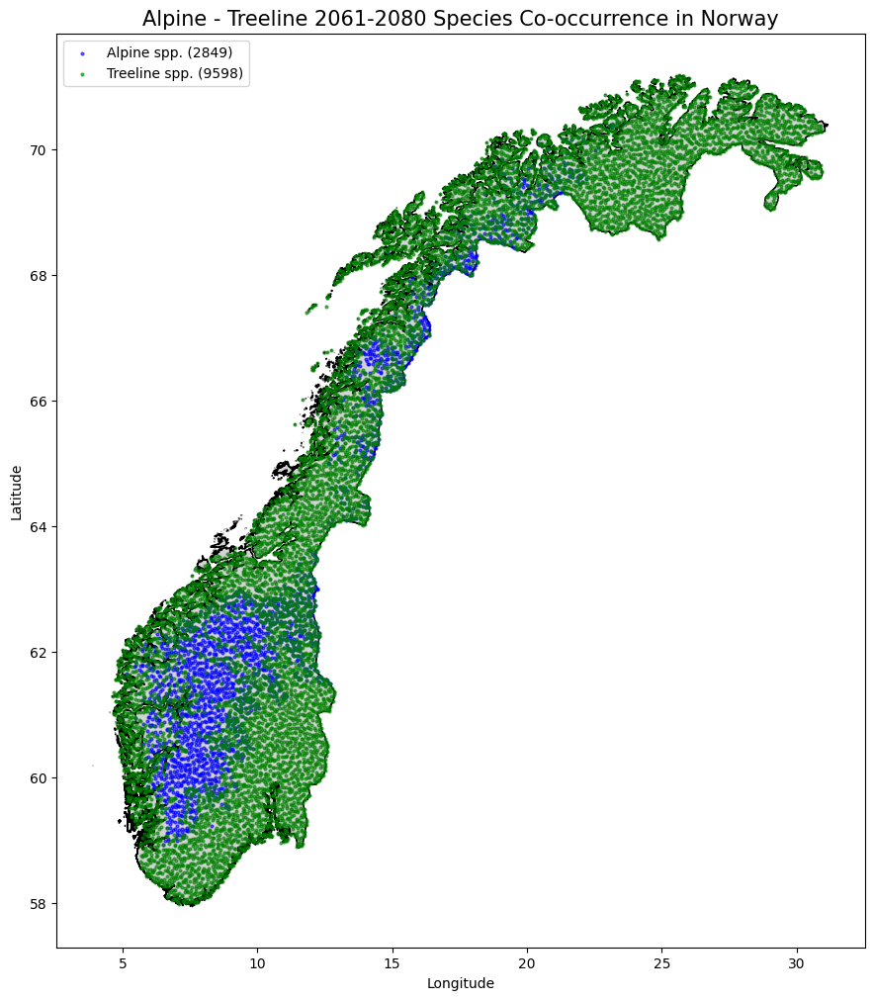

In [116]:
plot_combined_species_groups(df_2020_with_preds,alpine_sp_list,treeline_sp_list)

### Tests

In [76]:
# Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
specie_index = species_universe['Salix reticulata']
mask = df_2018_with_preds['predicted_vector'].apply(lambda x: x[specie_index] == 1)  # Check if species is present in predicted_vector

# Apply the mask to filter the DataFrame
filtered_df = df_2018_with_preds[mask]
filtered_df

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
702,"POLYGON ((7.36511 59.20052, 7.36311 59.20943, ...",59.205487,7.372789,"[[[846.0515, 11.944797, 6.769123, 19.826292, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",244
1036,"POLYGON ((6.80914 59.53648, 6.80697 59.54537, ...",59.541479,6.816806,"[[[1063.2517, 16.470514, 9.478959, 20.575836, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",205
1037,"POLYGON ((6.86381 59.53089, 6.86165 59.53978, ...",59.535884,6.871480,"[[[738.00146, 16.818768, 9.74937, 21.670605, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",225
1042,"POLYGON ((7.27896 59.50208, 7.27691 59.51098, ...",59.507048,7.286689,"[[[715.8514, 13.463226, 8.127726, 23.035929, 1...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",237
1045,"POLYGON ((7.55127 59.55403, 7.5493 59.56293, 7...",59.558984,7.559057,"[[[1173.3517, 6.4480596, 3.8052602, 8.6776085,...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...",246
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303


In [77]:
mask

0        False
1        False
2        False
3        False
4        False
         ...  
11465     True
11466     True
11467     True
11468     True
11469     True
Name: predicted_vector, Length: 11470, dtype: bool